<a href="https://colab.research.google.com/github/samuhin/TimeSeries/blob/main/TimeSeries.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Установка и импортирование библиотек

##Устанавливаем нестандартные библиотеки

###Библиотека для работы с котировками

In [1]:
!pip install yfinance

     |████████████████████████████████| 5.5MB 17.0MB/s 
  Created wheel for yfinance: filename=yfinance-0.1.55-py2.py3-none-any.whl size=22616 sha256=66b351357b3083d5f293c0dba2d1cf7e08202b029869814844ef0b1c3651715f
  Stored in directory: /root/.cache/pip/wheels/04/98/cc/2702a4242d60bdc14f48b4557c427ded1fe92aedf257d4565c
Successfully built yfinance
  Found existing installation: lxml 4.2.6
    Uninstalling lxml-4.2.6:
      Successfully uninstalled lxml-4.2.6


###Библиотека для работы с метриками

In [23]:
!pip install ml_metrics

  Created wheel for ml-metrics: filename=ml_metrics-0.1.4-cp37-none-any.whl size=7850 sha256=7468597d9d8cfb612ee927f916e489da4a14b5fe755250f763a9a8829cb53434
  Stored in directory: /root/.cache/pip/wheels/b3/61/2d/776be7b8a4f14c5db48c8e5451451cabc58dc6aa7ee3801163
Successfully built ml-metrics


##Импортируем основные библиотеки

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import yfinance
from matplotlib import pyplot
from pandas import read_csv
from pandas import DataFrame
from pandas import concat
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from keras.models import Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Dropout
from keras.layers import LSTM
from keras.layers import GRU
from keras.layers import SimpleRNN
from sklearn.linear_model import LinearRegression

##Конфигурация для получения изображений высокой чёткости

In [3]:
%config InlineBackend.figure_format = 'retina'

#Загрузка данных и предобработка данных

##Загрузка

Выбираем временной промежуток

In [4]:
start_date = '2017-01-01'
end_date = '2020-12-31'

Загружаем данные

In [5]:
 data = yfinance.download("AUDUSD=X CADUSD=X CHFUSD=X \
                          CNYUSD=X DKKUSD=X EURUSD=X \
                          GBPUSD=X HKDUSD=X JPYUSD=X \
                          KZTUSD=X NOKUSD=X NZDUSD=X \
                          PLNUSD=X RUBUSD=X SEKUSD=X",
                        start=start_date, end=end_date)

[*********************100%***********************]  15 of 15 completed


Посмотрим на скачанные данные (закрытие)

In [6]:
 data['Close'].head()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
Date,,,,,,,,,,,,,,,
2017-01-02,0.720981,0.744380,0.981653,0.144013,0.141589,1.052698,1.234903,0.128949,0.008562,0.003012,0.115845,0.693433,0.239261,0.016332,0.110110
2017-01-03,0.719683,0.743970,0.976381,0.144009,0.140689,1.046003,1.228199,0.128901,0.008511,0.003022,0.115547,0.693193,0.237208,0.016332,0.109632
2017-01-04,0.722993,0.745057,0.974564,0.143682,0.140155,1.041992,1.224560,0.128927,0.008499,0.003028,0.115737,0.692377,0.237595,0.016414,0.109269
2017-01-05,0.728704,0.751936,0.980277,0.144402,0.141231,1.050089,1.232681,0.128950,0.008539,0.003036,0.116524,0.696330,0.240393,0.016566,0.109964
2017-01-06,0.733837,0.755892,0.990305,0.145182,0.142680,1.060592,1.242545,0.128959,0.008676,0.003062,0.117927,0.702149,0.243142,0.016835,0.111151


Посмотрим описание данных

In [7]:
 data['Close'].describe()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
count,1021.000000,1021.000000,1021.000000,1020.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000
mean,0.725972,0.760871,1.028447,0.147448,0.153501,1.144000,1.297346,0.128135,0.009128,0.002769,0.116271,0.679164,0.265455,0.015635,0.112031
std,0.042692,0.022069,0.033005,0.004888,0.006193,0.045590,0.046177,0.000614,0.000233,0.000281,0.007867,0.034528,0.013252,0.001421,0.006710
min,0.574290,0.689741,0.974564,0.139315,0.140155,1.041992,1.149439,0.127369,0.008499,0.002201,0.085035,0.562610,0.233536,0.012358,0.095797
25%,0.697204,0.749176,1.005429,0.144161,0.149027,1.112929,1.268875,0.127514,0.008950,0.002592,0.111079,0.657138,0.258160,0.014896,0.106778
50%,0.723589,0.759359,1.019056,0.145966,0.152488,1.137540,1.296512,0.128008,0.009113,0.002679,0.116989,0.678509,0.264643,0.015673,0.111624
75%,0.758743,0.772917,1.040139,0.150578,0.158213,1.177745,1.320795,0.128810,0.009298,0.003037,0.122119,0.704072,0.272327,0.016909,0.115864
max,0.811688,0.825948,1.134327,0.159551,0.168059,1.251001,1.434206,0.129039,0.009698,0.003263,0.130875,0.752570,0.301181,0.017976,0.127521


##Предобработка

Заполним пропуски в данных

In [8]:
 new_data = data['Close'].interpolate(method='polynomial', order=3)

Посмотрим на результаты заполнения

In [9]:
 new_data.describe()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
count,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000
mean,0.725972,0.760871,1.028447,0.147444,0.153501,1.144000,1.297346,0.128135,0.009128,0.002769,0.116271,0.679164,0.265455,0.015635,0.112031
std,0.042692,0.022069,0.033005,0.004888,0.006193,0.045590,0.046177,0.000614,0.000233,0.000281,0.007867,0.034528,0.013252,0.001421,0.006710
min,0.574290,0.689741,0.974564,0.139315,0.140155,1.041992,1.149439,0.127369,0.008499,0.002201,0.085035,0.562610,0.233536,0.012358,0.095797
25%,0.697204,0.749176,1.005429,0.144161,0.149027,1.112929,1.268875,0.127514,0.008950,0.002592,0.111079,0.657138,0.258160,0.014896,0.106778
50%,0.723589,0.759359,1.019056,0.145964,0.152488,1.137540,1.296512,0.128008,0.009113,0.002679,0.116989,0.678509,0.264643,0.015673,0.111624
75%,0.758743,0.772917,1.040139,0.150577,0.158213,1.177745,1.320795,0.128810,0.009298,0.003037,0.122119,0.704072,0.272327,0.016909,0.115864
max,0.811688,0.825948,1.134327,0.159551,0.168059,1.251001,1.434206,0.129039,0.009698,0.003263,0.130875,0.752570,0.301181,0.017976,0.127521


#Подготовка к анализу данных как временного ряда

Напишем функция для преобразование данных в удобную форму для работы с ними

In [10]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

Введём дополнительные регрессоры (если нужно)

In [11]:
#new_data['day'] = new_data.index.day
#new_data['month'] = new_data.index.month

Переведём данные в numpy-массив:

In [12]:
values = new_data.values
values

array([[0.72098053, 0.74437994, 0.98165292, ..., 0.23926078, 0.01633152,
        0.11011021],
       [0.71968335, 0.7439701 , 0.97638136, ..., 0.23720796, 0.01633232,
        0.1096323 ],
       [0.7229926 , 0.74505657, 0.97456384, ..., 0.2375946 , 0.01641416,
        0.10926872],
       ...,
       [0.7588923 , 0.77881616, 1.12574577, ..., 0.27210575, 0.01352622,
        0.1210579 ],
       [0.76098984, 0.77990347, 1.13109374, ..., 0.26990852, 0.01350961,
        0.12188224],
       [0.76892906, 0.7842707 , 1.13432705, ..., 0.2686179 , 0.01341886,
        0.12211846]])

Посмотрим какая у него размерность

In [13]:
values.shape 

(1021, 15)

Сделаем преобразование MinMaxScale для данных

In [14]:
# ensure all data is float
values = values.astype('float32')
# normalize features
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(values)

Посмотрим что получилось:

In [15]:
 scaled

array([[0.6179085 , 0.4011469 , 0.04437256, ..., 0.08463311, 0.7072511 ,
        0.45117784],
       [0.6124444 , 0.39813805, 0.01137638, ..., 0.05428648, 0.70739365,
        0.4361136 ],
       [0.626384  , 0.40611458, 0.        , ..., 0.06000233, 0.7219608 ,
        0.4246533 ],
       ...,
       [0.77760553, 0.6539693 , 0.94628763, ..., 0.57017875, 0.20794702,
        0.796262  ],
       [0.7864411 , 0.661952  , 0.9797621 , ..., 0.5376971 , 0.20499039,
        0.8222463 ],
       [0.8198838 , 0.6940155 , 1.        , ..., 0.5186181 , 0.18883777,
        0.8296921 ]], dtype=float32)

#Разделение выборки на обучающую, тестовую и валидационную

Посмотрим сколько у нас всего единиц времени

In [16]:
len(values)

1021

Настроим параметры и поделим

In [17]:
# specify the number of lag hours
n_hours = 3
n_features = scaled.shape[1]
n_predict = 1

# frame as supervised learning
reframed = series_to_supervised(scaled, n_hours, n_predict)

# split into train and test sets
values = reframed.values

n_train_hours = 500
n_val_hours = 200

train = values[:n_train_hours, :]
test = values[n_train_hours:-n_val_hours, :]
valid = values[-n_val_hours:, :]

# split into input and outputs
n_obs = n_hours * n_features
train_X, train_y = train[:, :n_obs], train[:, n_obs:]
test_X, test_y = test[:, :n_obs], test[:, n_obs:]
valid_X, valid_y = valid[:, :n_obs], valid[:, n_obs:]

# reshape input to be 3D [samples, timesteps, features]
train_X = train_X.reshape((train_X.shape[0], n_hours, n_features))
test_X = test_X.reshape((test_X.shape[0], n_hours, n_features))
valid_X = valid_X.reshape((valid_X.shape[0], n_hours, n_features))

Проверим, что всё правильно

In [19]:
len(reframed)

1018

In [18]:
len(train) + len(test) + len(valid)

1018

#Анализ

##Метрики

In [24]:
import ml_metrics as metrics

###MSE

In [33]:
def MSE(y_hat, y_pred):
  pass
  return metrics.mse(y_hat, y_pred)

###RMSE

In [34]:
def RMSE(y_hat, y_pred):
  pass
  return metrics.rmse(y_hat, y_pred)

###MAE

In [35]:
def MAE(y_hat, y_pred):
  pass
  return metrics.mae(y_hat, y_pred)

##Наивный алгоритм

Составляем предсказание

In [27]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.concatenate((temp_pred, np.array([temp_pred[-n:][-1]])))
    y_pred.append(temp_pred[-1])
  i = i + n

Выполяем обратное преобразование

In [28]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим график предсказания

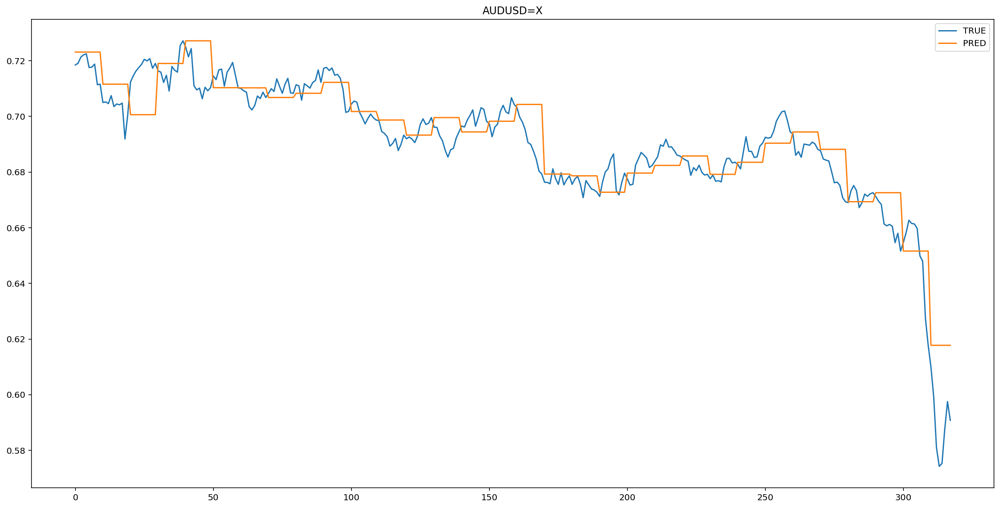

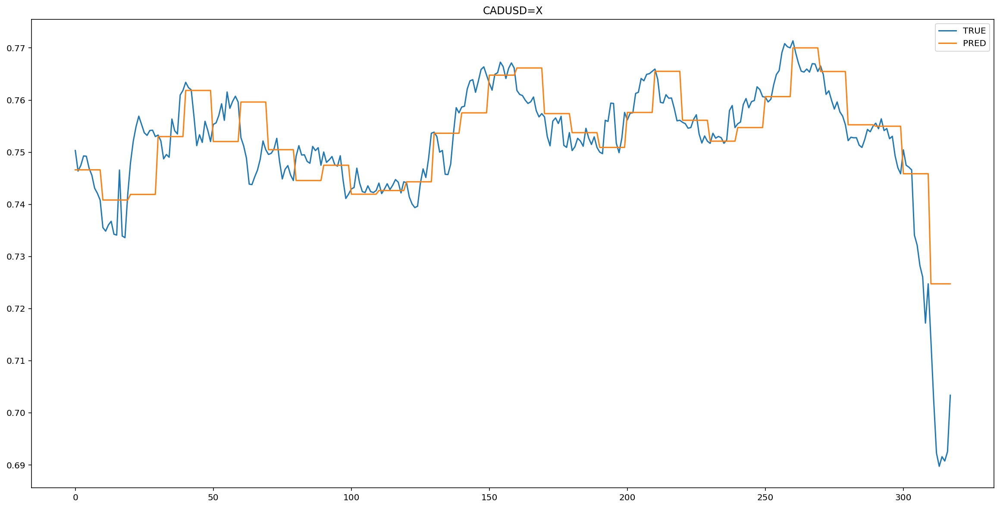

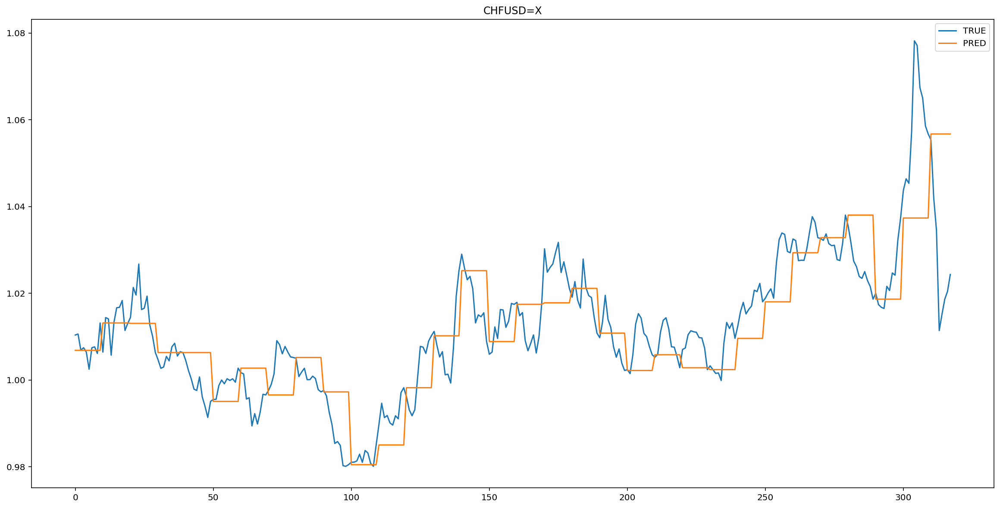

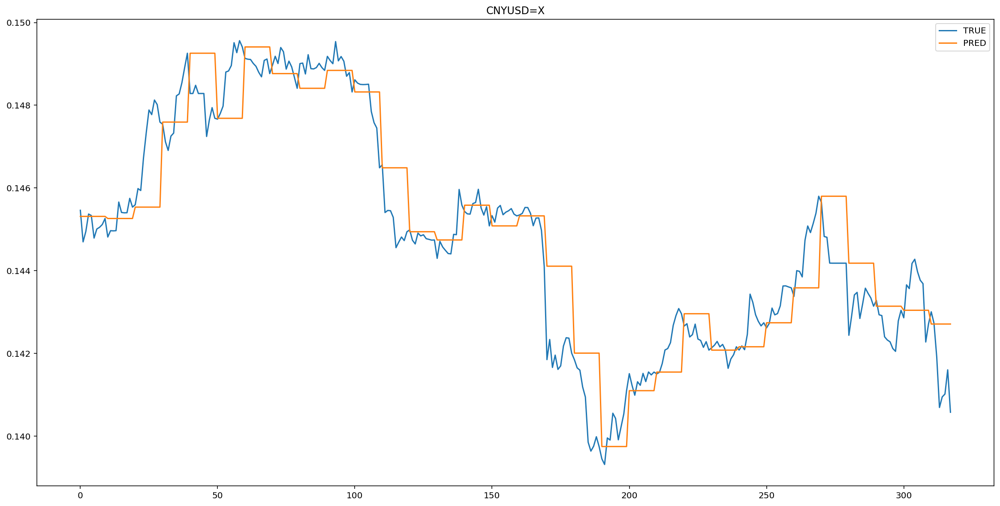

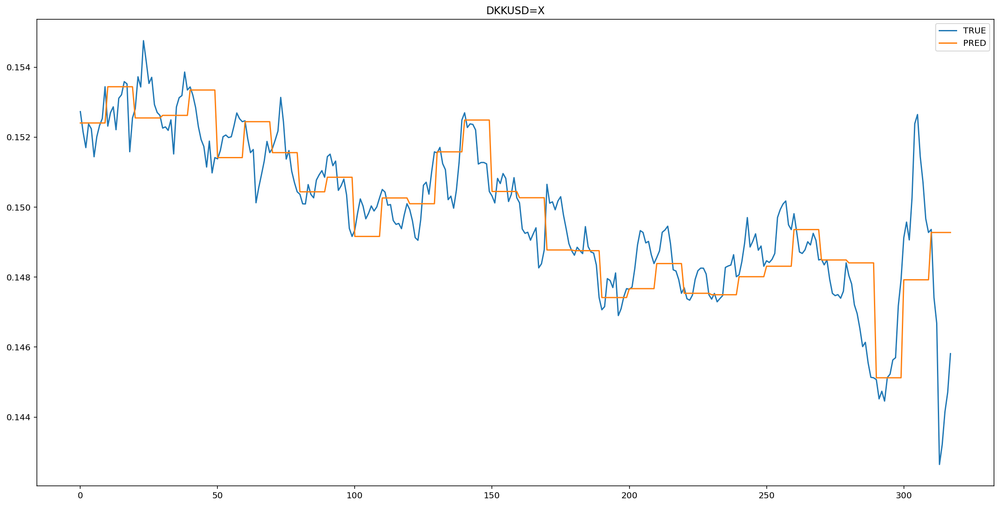

...

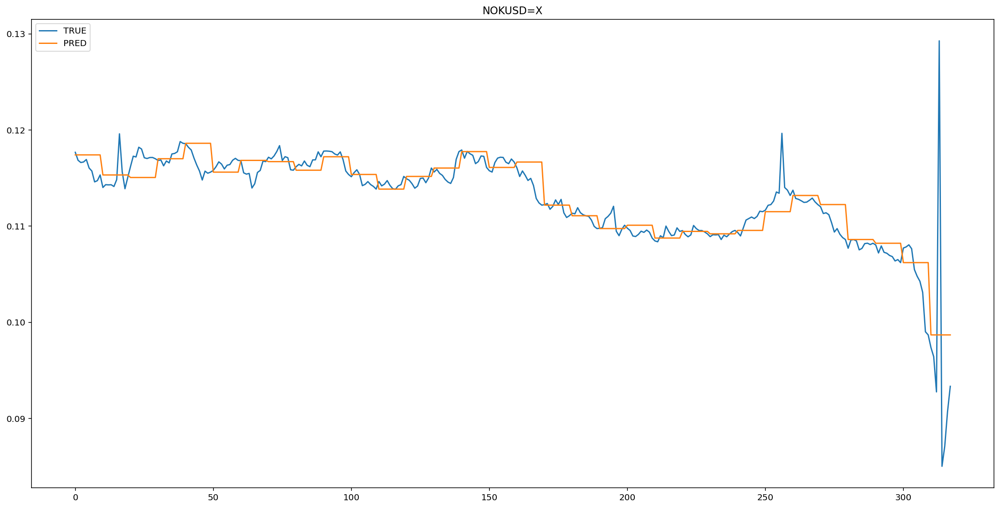

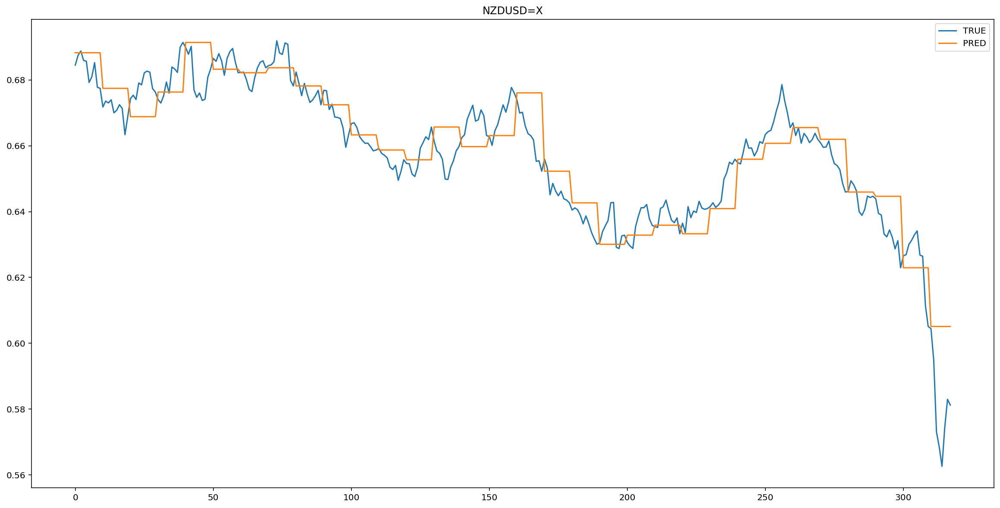

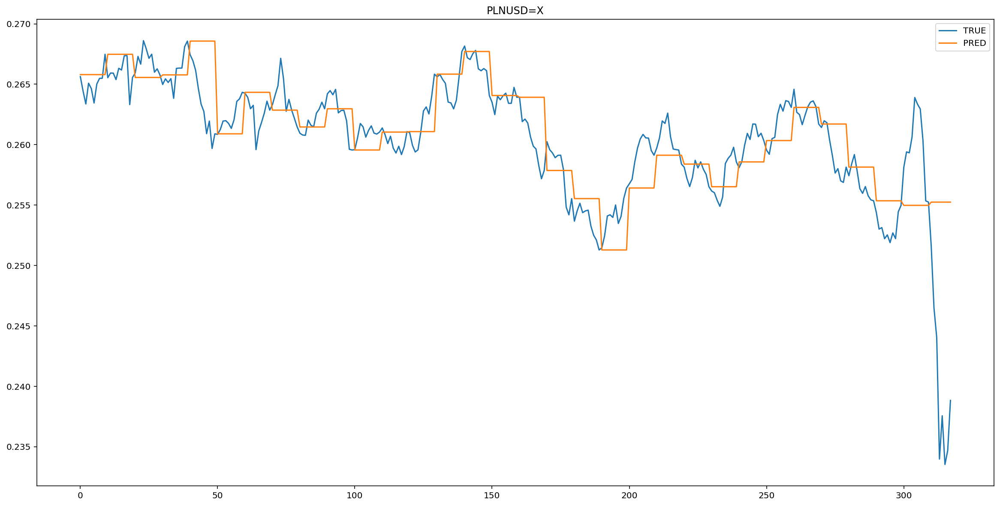

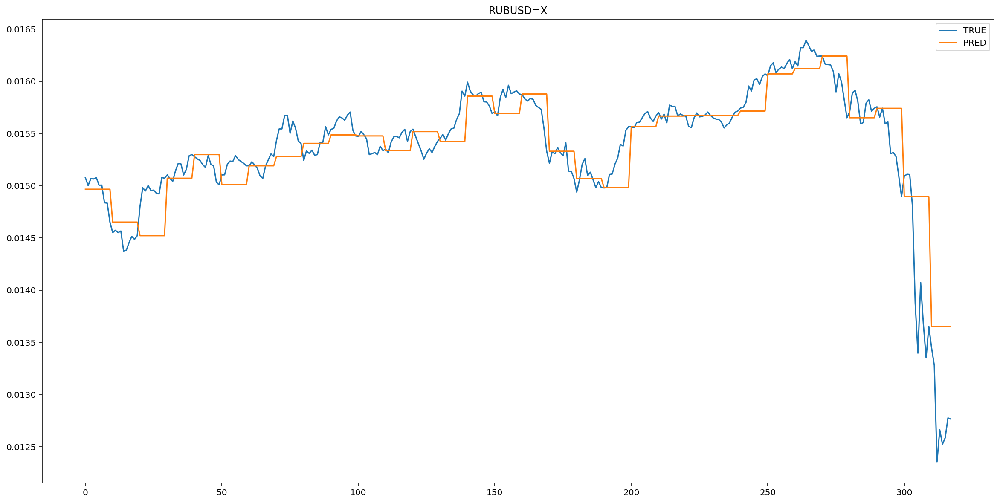

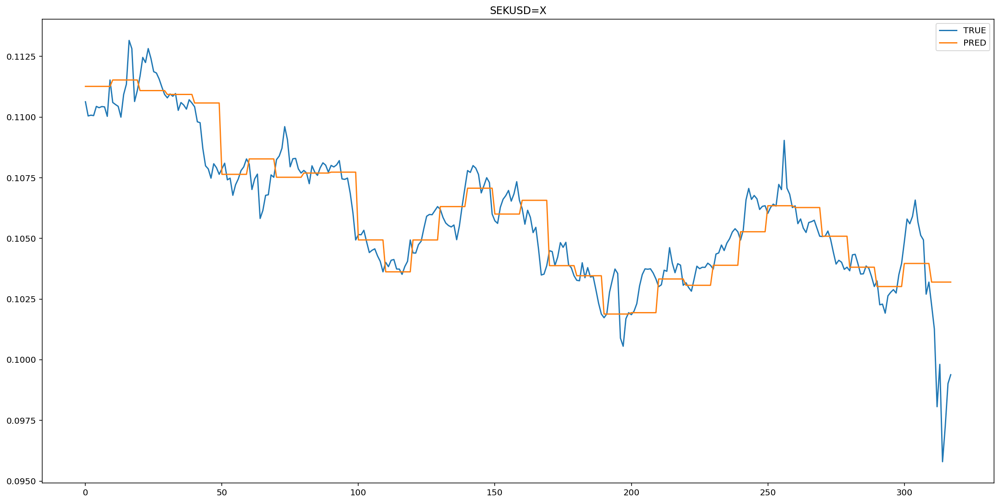

In [29]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

###Оцениваем точность

In [37]:
MSE(y_hat, y_pred)

5.158564e-05

In [39]:
RMSE(y_hat, y_pred)

0.0071823145

In [40]:
MAE(y_hat, y_pred)

0.0033960706

##Среднее

###Простое среднее

Составляем предсказание

In [41]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.array([temp_pred[-n:].mean(axis = 0)]) #простое среднее
    y_pred.append(temp_pred[-1])
  i = i + n

Делаем обратное предсказание

In [42]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим графики

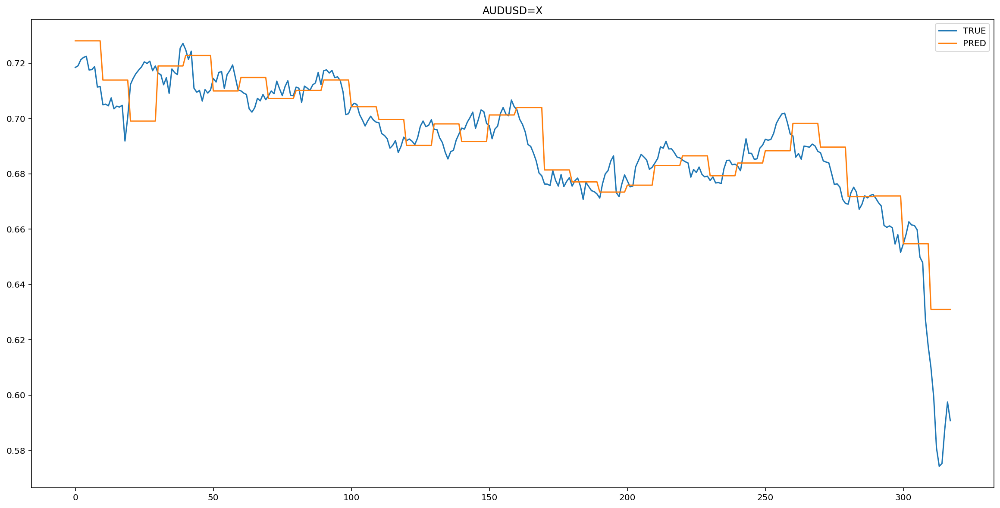

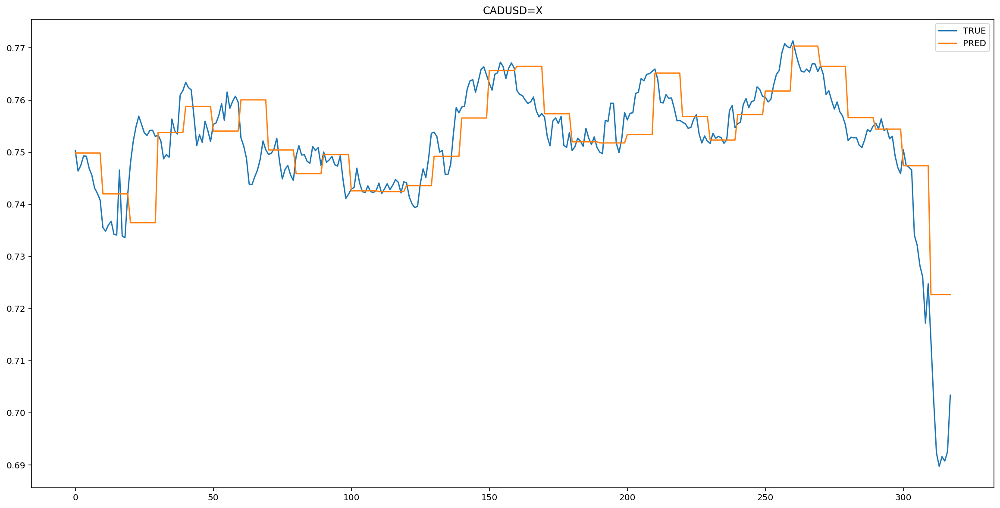

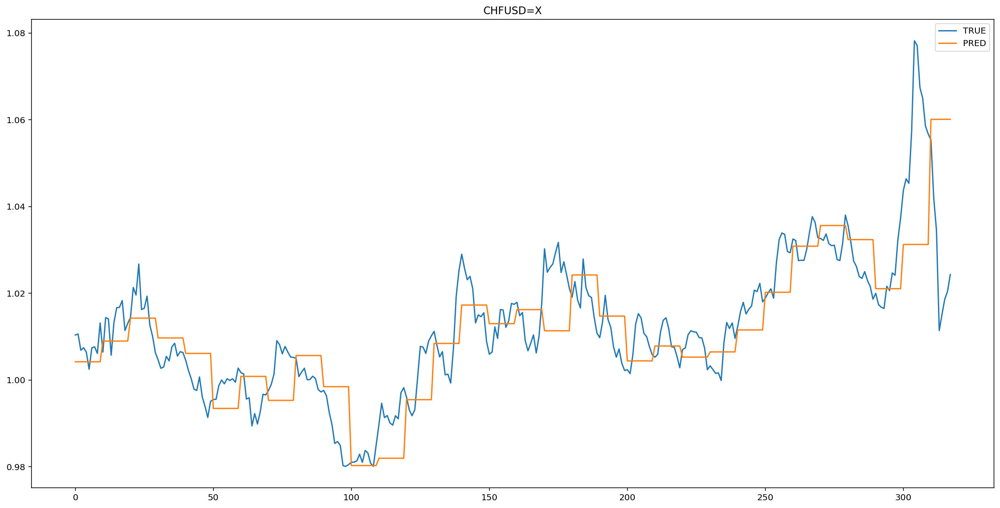

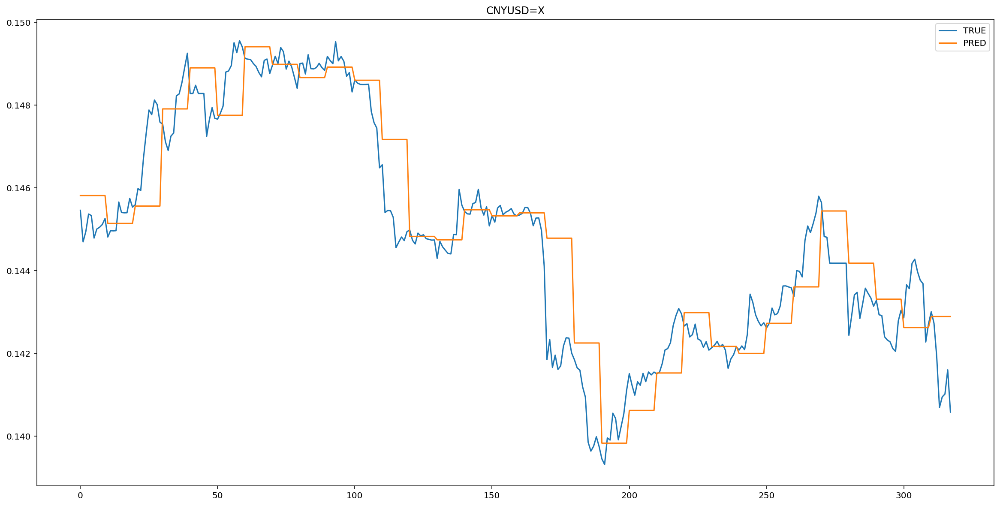

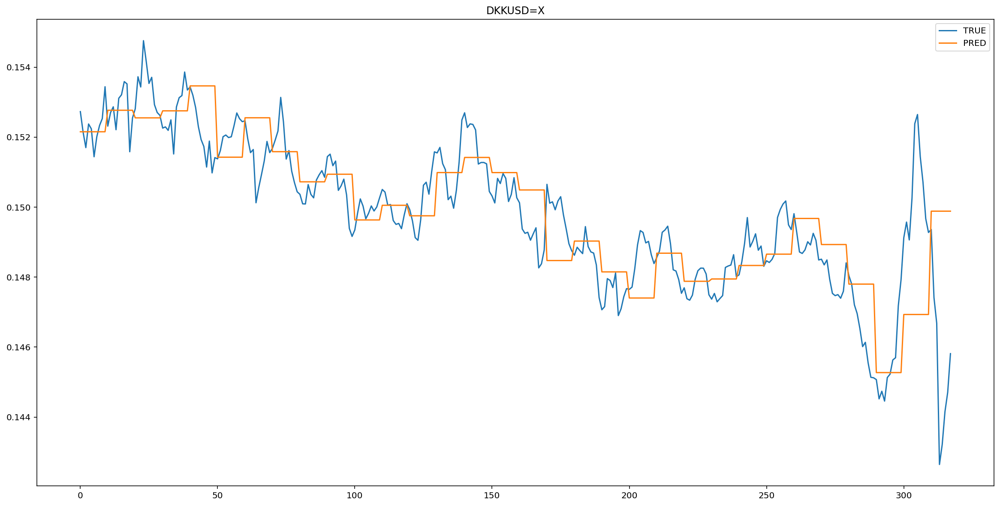

...

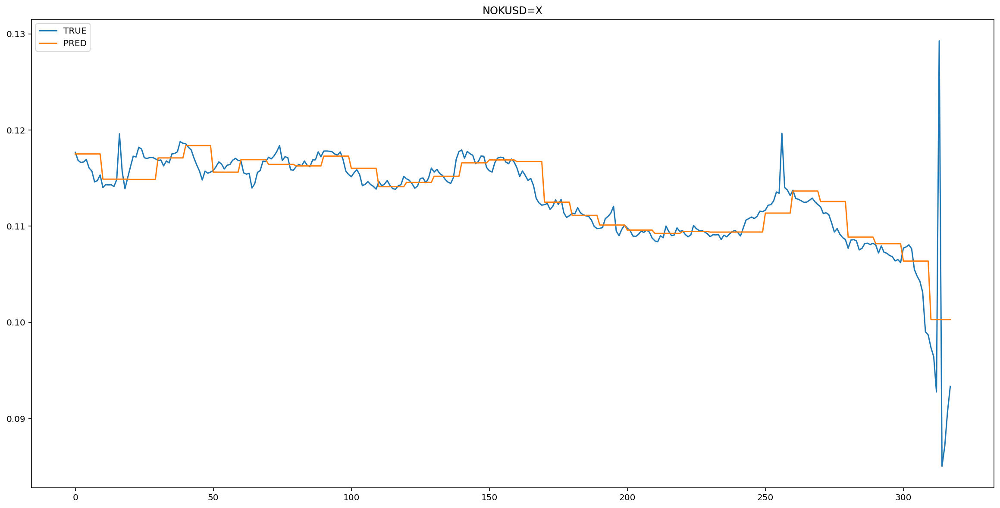

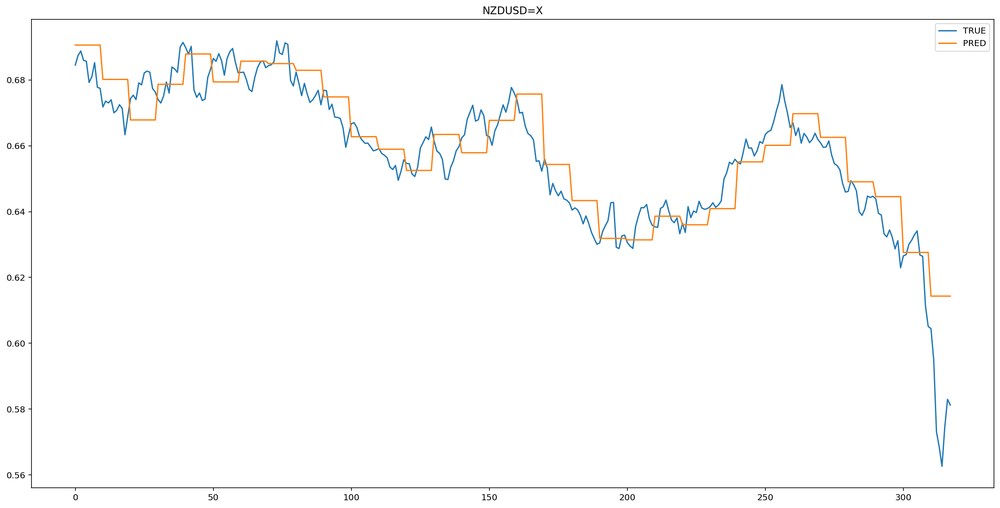

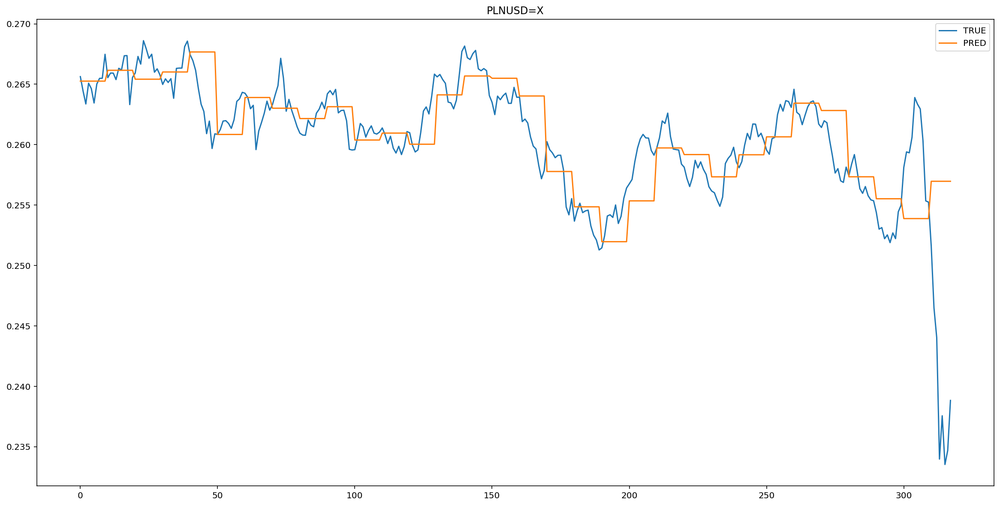

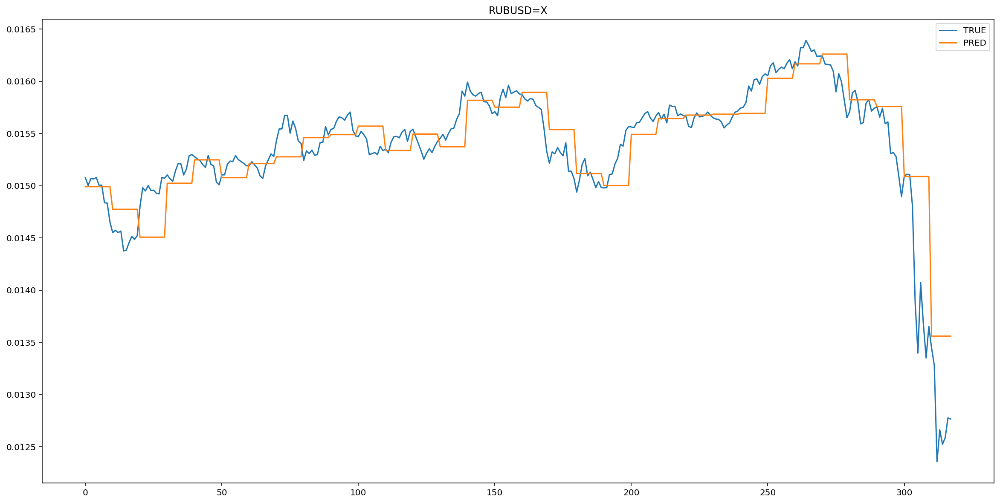

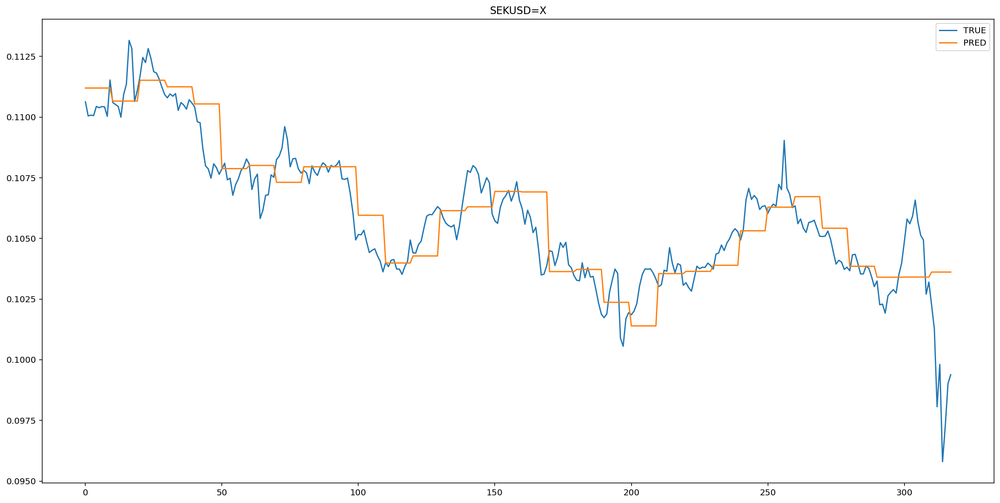

In [43]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [44]:
MSE(y_hat, y_pred)

6.3315485e-05

In [45]:
RMSE(y_hat, y_pred)

0.007957103

In [46]:
MAE(y_hat, y_pred)

0.0036254444

###Скользящее среднее

Составляем прогноз

In [47]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.concatenate((temp_pred, np.array([temp_pred[-n:].mean(axis = 0)]))) #скользящее среднее
    y_pred.append(temp_pred[-1])
  i = i + n


Делаем обратное преобразование

In [48]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим график

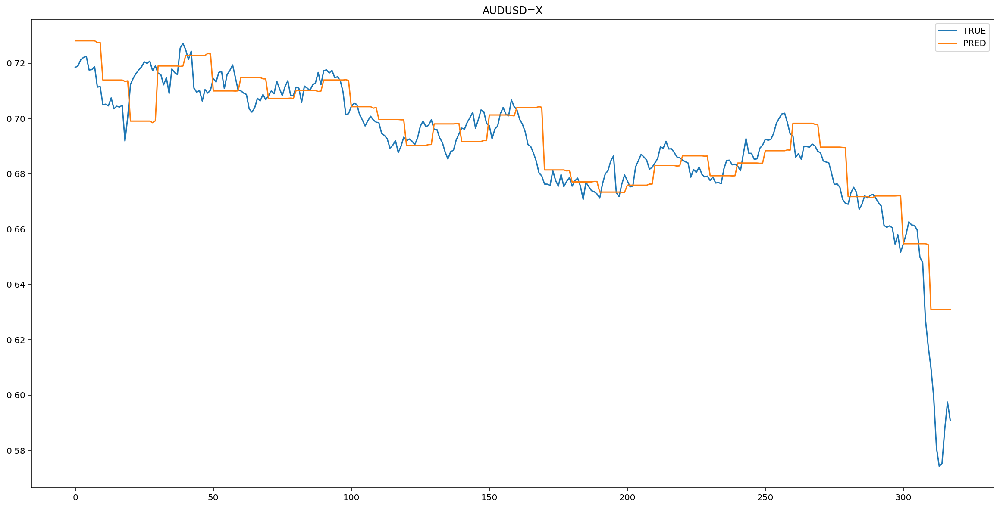

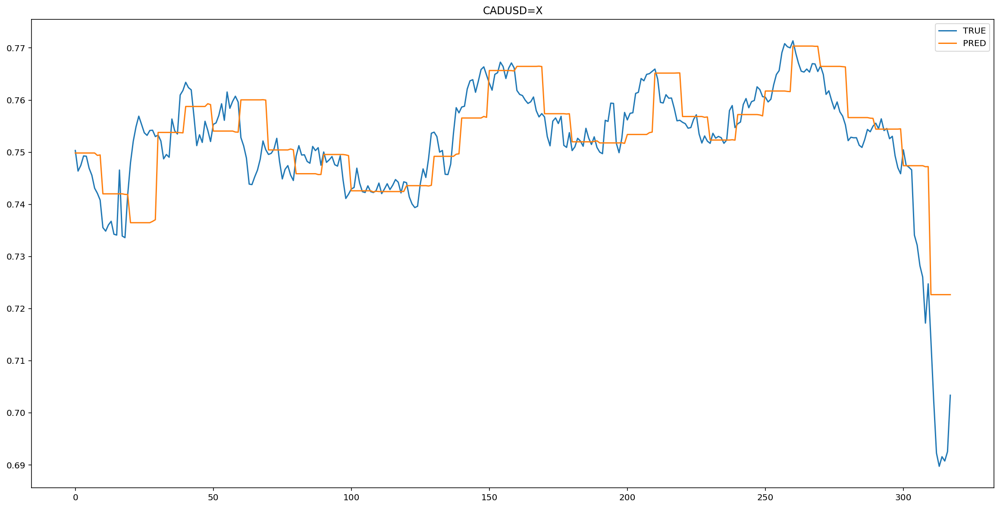

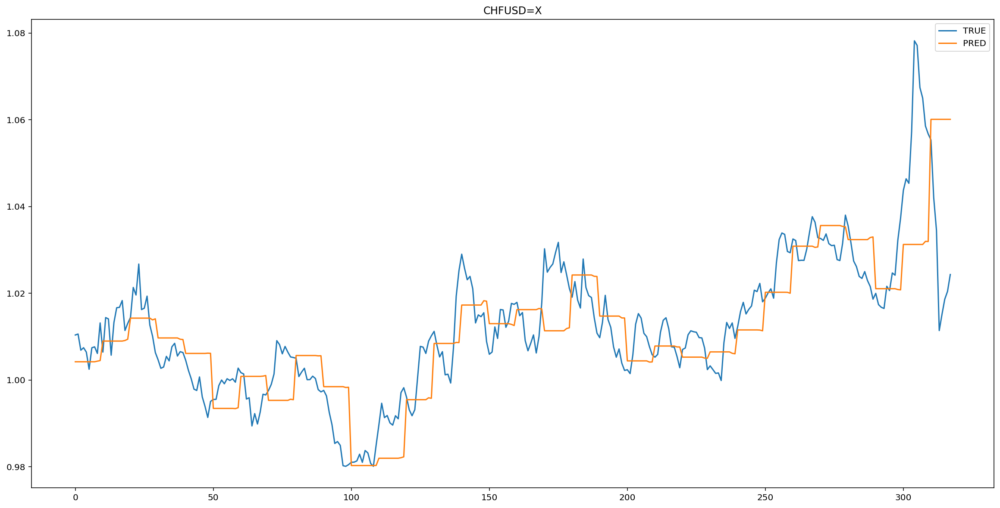

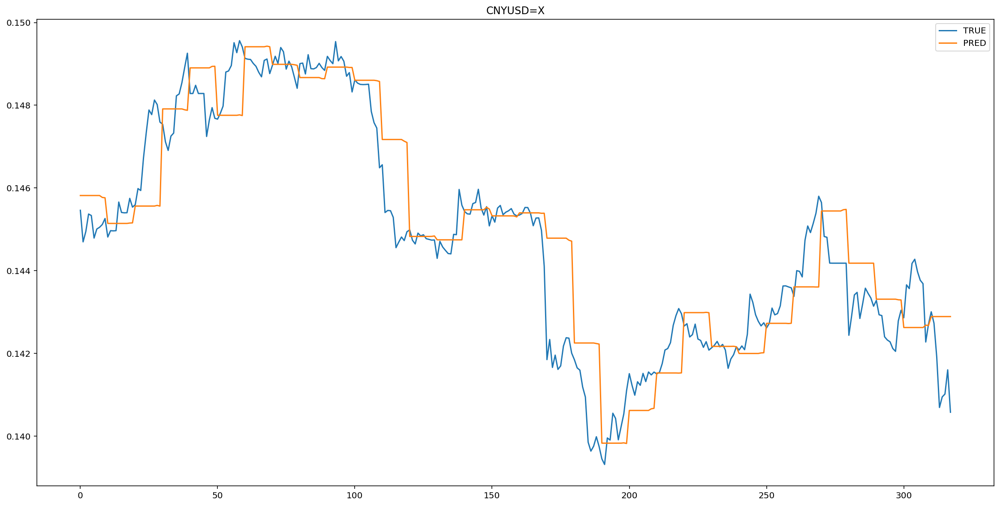

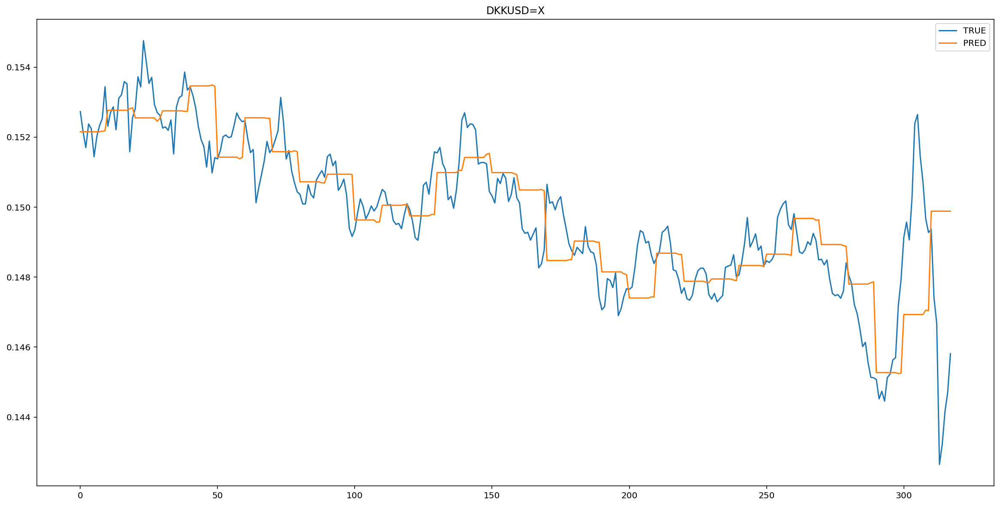

...

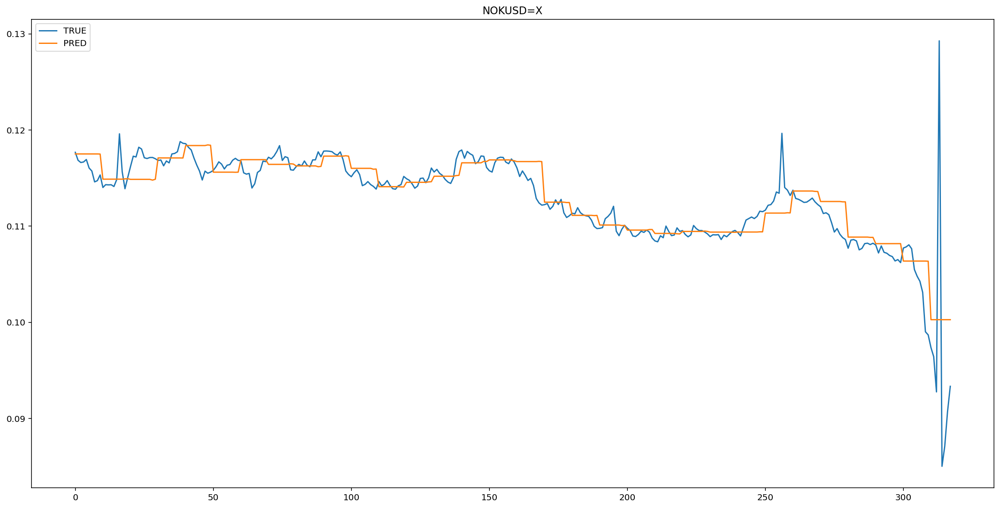

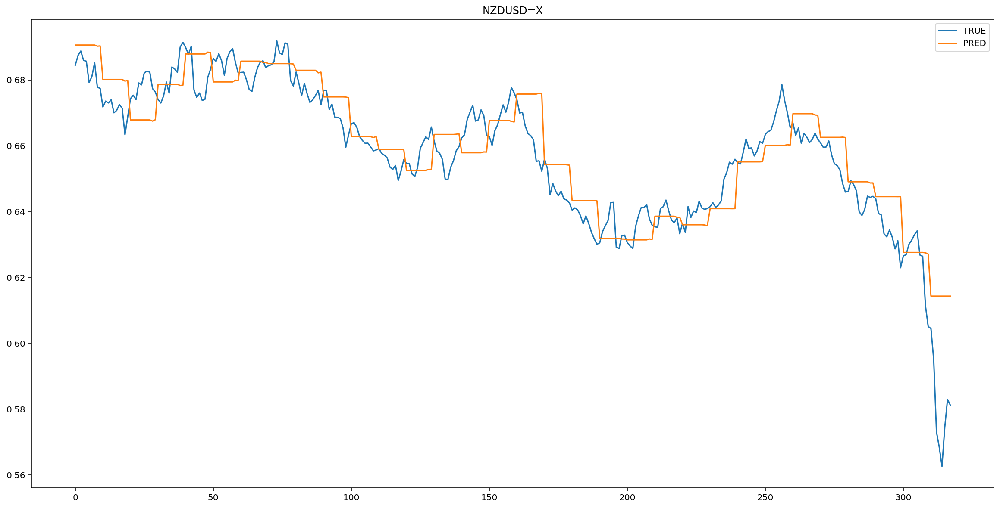

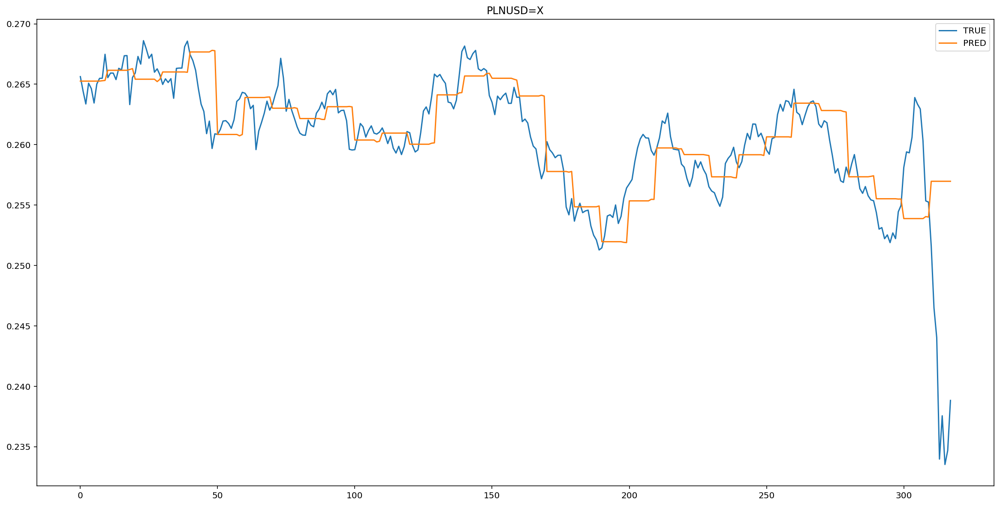

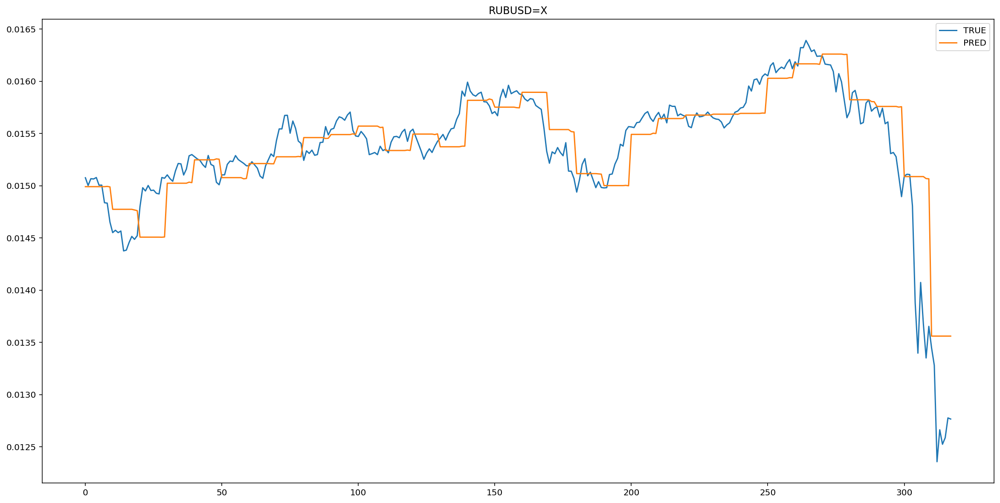

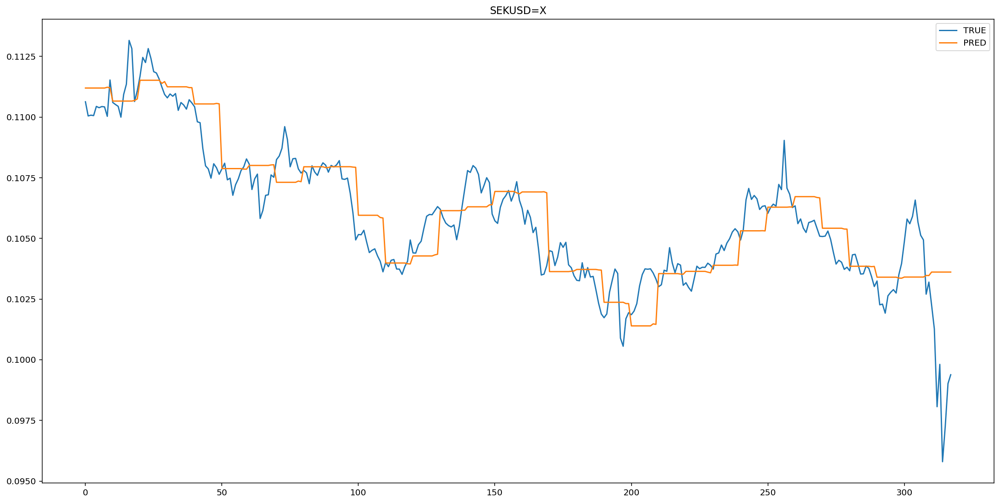

In [49]:
for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [50]:
MSE(y_hat, y_pred)

6.319347e-05

In [51]:
RMSE(y_hat, y_pred)

0.007949431

In [52]:
MAE(y_hat, y_pred)

0.003621617

##Регрессия

Импортируем библиотеки

In [53]:
from sklearn.linear_model import Ridge, Lasso

###Простая линейная

Строим модель

In [54]:
linear_model = LinearRegression()
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

Считаем score

In [55]:
 linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9017175020352824

###Lasso

Строим модель

In [56]:
linear_model = Lasso(alpha=0.0001)
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

Lasso(alpha=0.0001, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)

Считаем score

In [57]:
linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9344537528525748

###Ridge

Строим модель

In [58]:
linear_model = Ridge(alpha=0.004)
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

Ridge(alpha=0.004, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001)

Считаем score

In [59]:
linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9094084816659253

##ARIMA

###ARIMA

###SARIMAX

###VAR

In [60]:
from statsmodels.tsa.api import VAR 

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [61]:
model = VAR(train_y)

In [62]:
results = model.fit(ic='aic') 

In [63]:
y_pred = []

for i in range(len(test_X)):
  y_pred.append(results.forecast(test_X[i], 1)[0])
y_pred = scaler.inverse_transform(np.array(y_pred))
y_hat = scaler.inverse_transform(test_y)

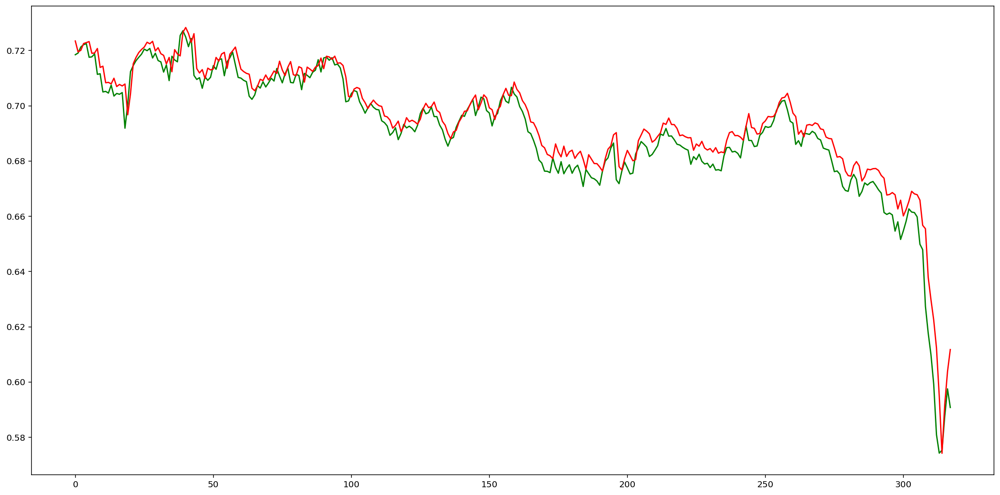

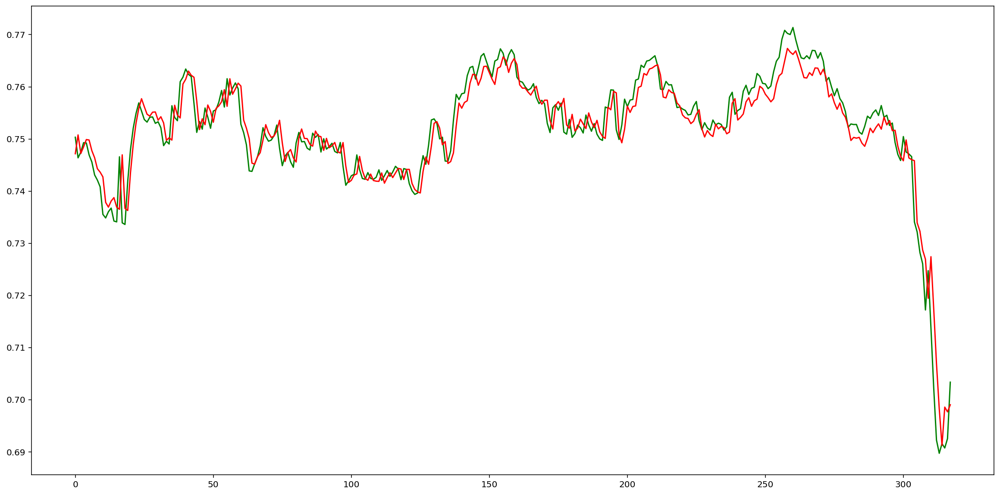

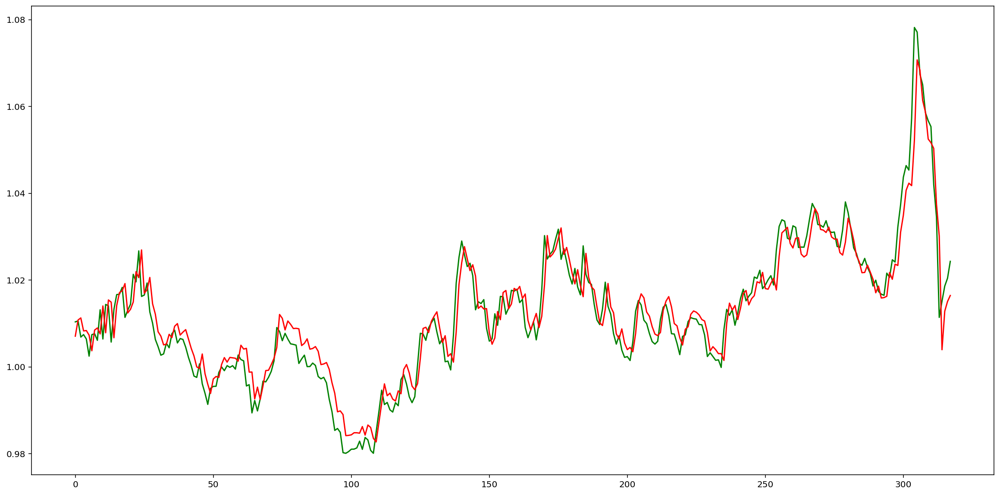

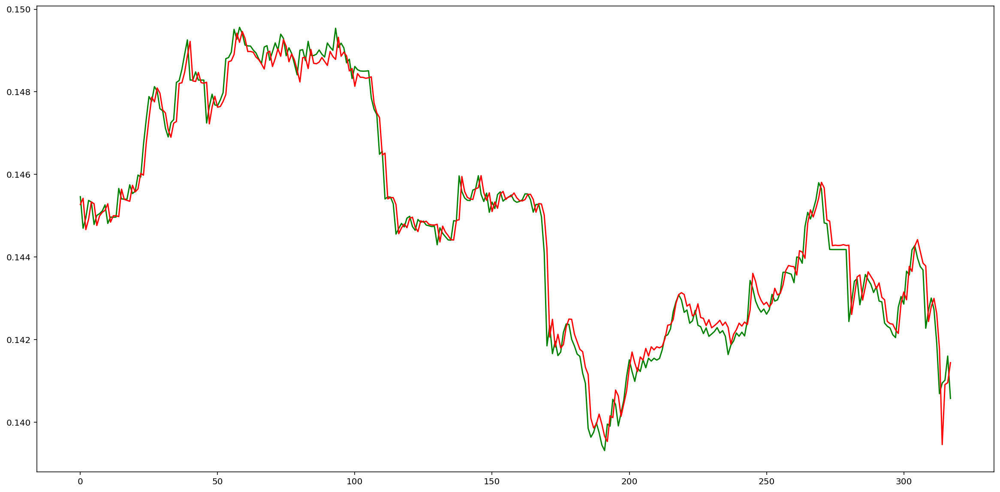

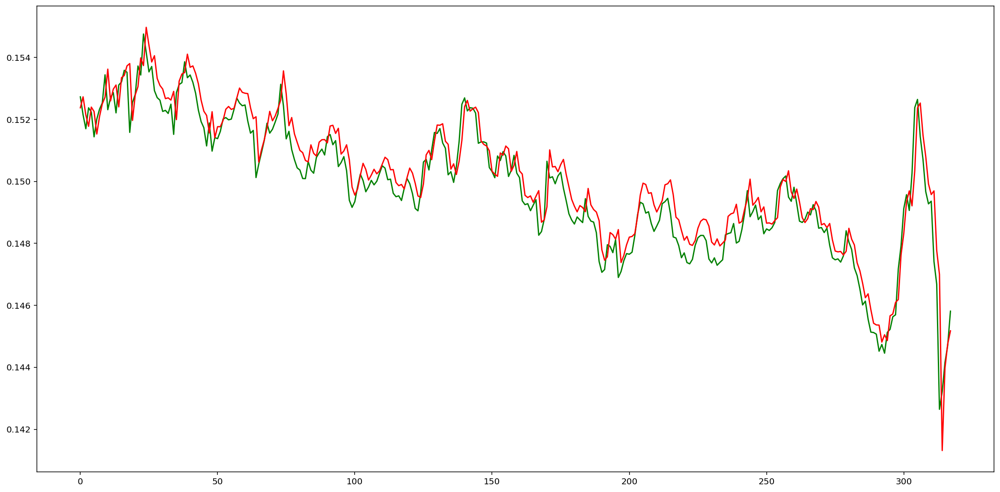

...

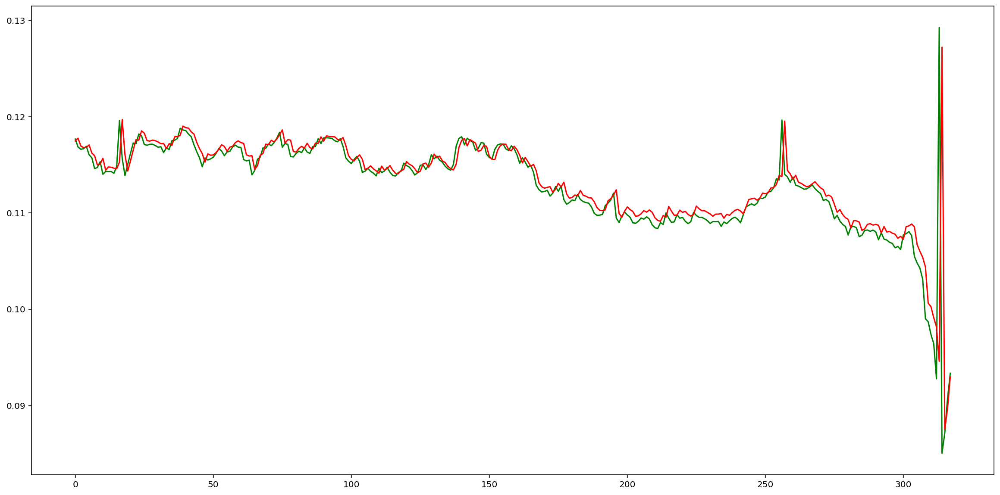

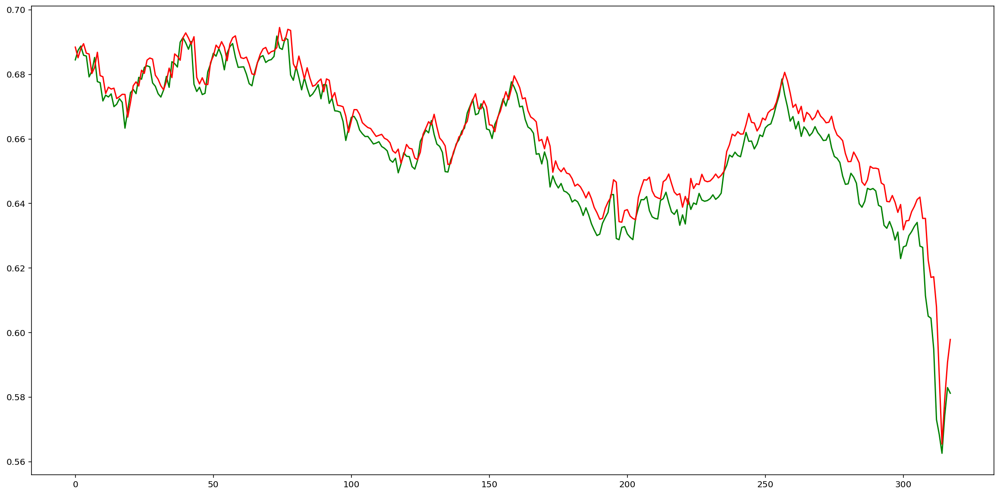

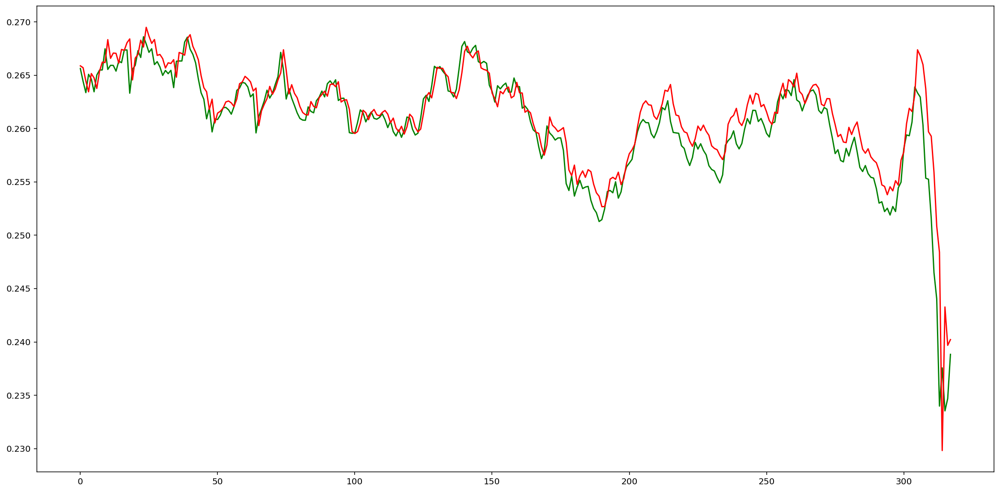

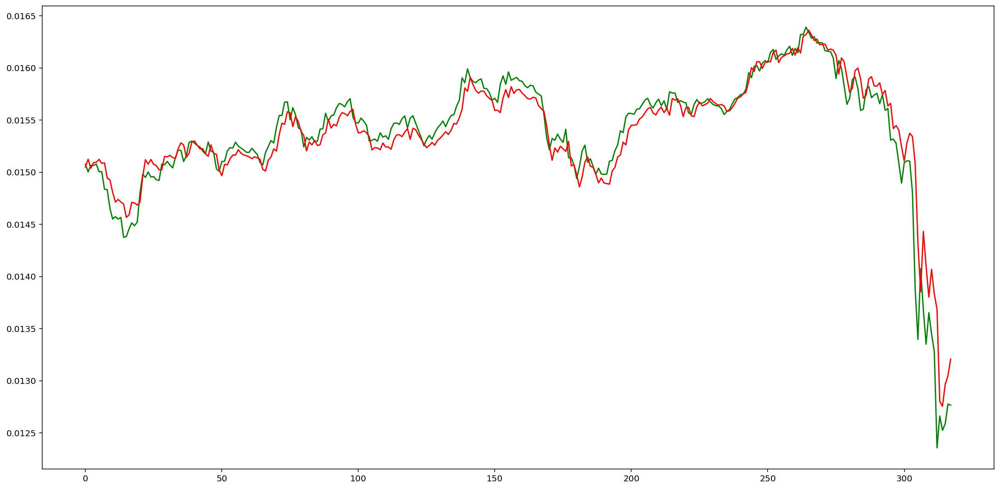

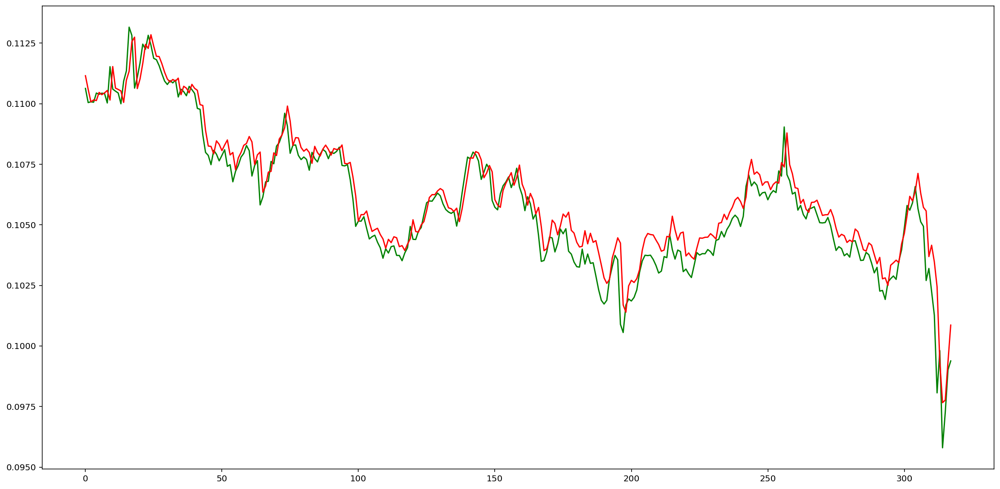

In [64]:
for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.plot(y_hat[:, i], color='green')
    plt.plot(y_pred[:, i], color='red')

####Оцениваем точность

In [65]:
MSE(y_hat, y_pred)

1.8739224513879572e-05

In [66]:
RMSE(y_hat, y_pred)

0.004328882594143617

In [67]:
MAE(y_hat, y_pred)

0.0021087291877444807

###VARIMAX

####Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

5.158564e-05

In [ ]:
RMSE(y_hat, y_pred)

0.0071823145

In [ ]:
MAE(y_hat, y_pred)

0.0033960706

##Нейронные сети

###Перцептрон

In [68]:
 # design network
model = Sequential()
model.add(Dense(128, input_shape=(train_X.shape[1], train_X.shape[2]), activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Flatten())
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
4/4 - 3s - loss: 0.3407 - val_loss: 0.1072
Epoch 2/100
4/4 - 0s - loss: 0.1595 - val_loss: 0.0427
Epoch 3/100
4/4 - 0s - loss: 0.0531 - val_loss: 0.0277
Epoch 4/100
4/4 - 0s - loss: 0.0352 - val_loss: 0.0381
Epoch 5/100
4/4 - 0s - loss: 0.0383 - val_loss: 0.0299
Epoch 6/100
4/4 - 0s - loss: 0.0240 - val_loss: 0.0210
Epoch 7/100
4/4 - 0s - loss: 0.0185 - val_loss: 0.0186
Epoch 8/100
4/4 - 0s - loss: 0.0171 - val_loss: 0.0184
Epoch 9/100
4/4 - 0s - loss: 0.0142 - val_loss: 0.0191
Epoch 10/100
4/4 - 0s - loss: 0.0112 - val_loss: 0.0194
Epoch 11/100
4/4 - 0s - loss: 0.0091 - val_loss: 0.0192
Epoch 12/100
4/4 - 0s - loss: 0.0081 - val_loss: 0.0186
Epoch 13/100
4/4 - 0s - loss: 0.0070 - val_loss: 0.0181
Epoch 14/100
4/4 - 0s - loss: 0.0058 - val_loss: 0.0180
Epoch 15/100
4/4 - 0s - loss: 0.0053 - val_loss: 0.0180
Epoch 16/100
4/4 - 0s - loss: 0.0052 - val_loss: 0.0175
Epoch 17/100
4/4 - 0s - loss: 0.0049 - val_loss: 0.0173
Epoch 18/100
4/4 - 0s - loss: 0.0048 - val_loss: 0.0173
E

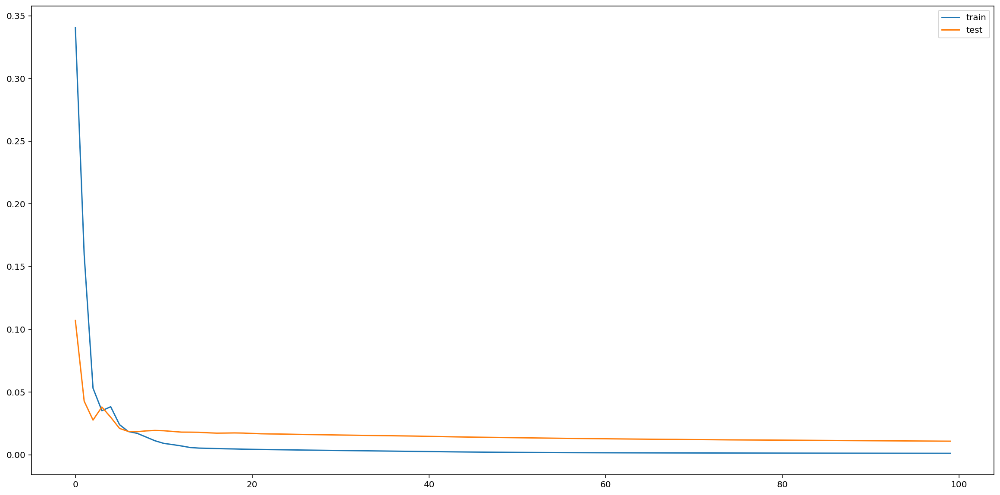

In [69]:
# fit network
history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
#history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y, epochs=100, batch_size=128, validation_data=(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1), test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [70]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

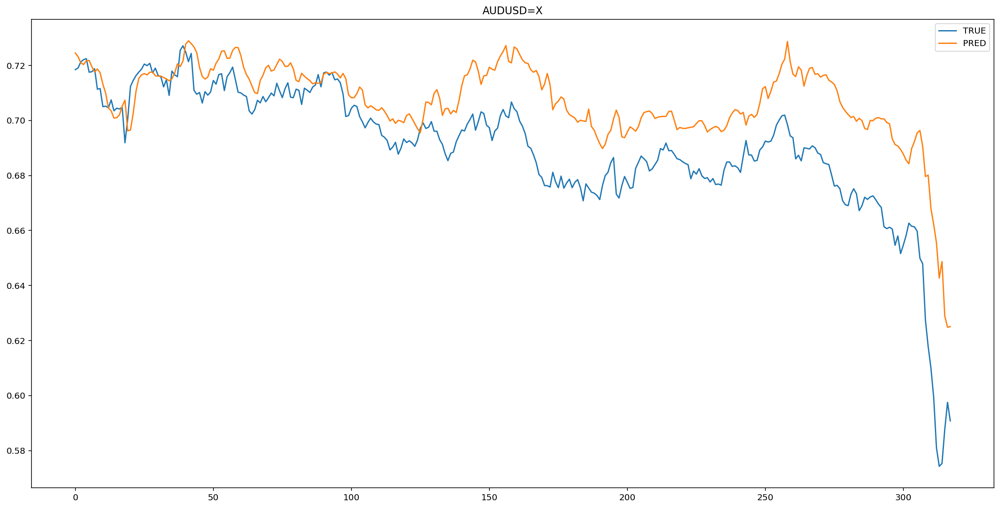

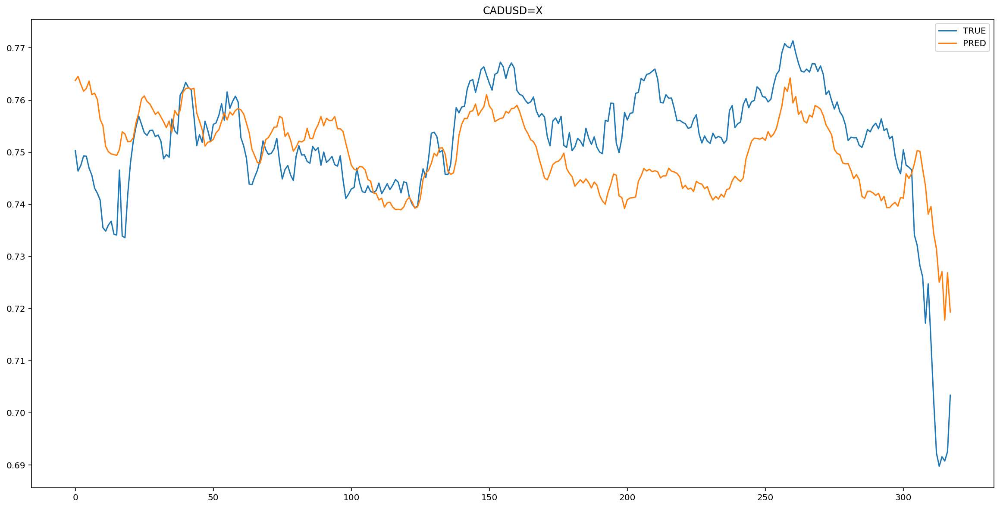

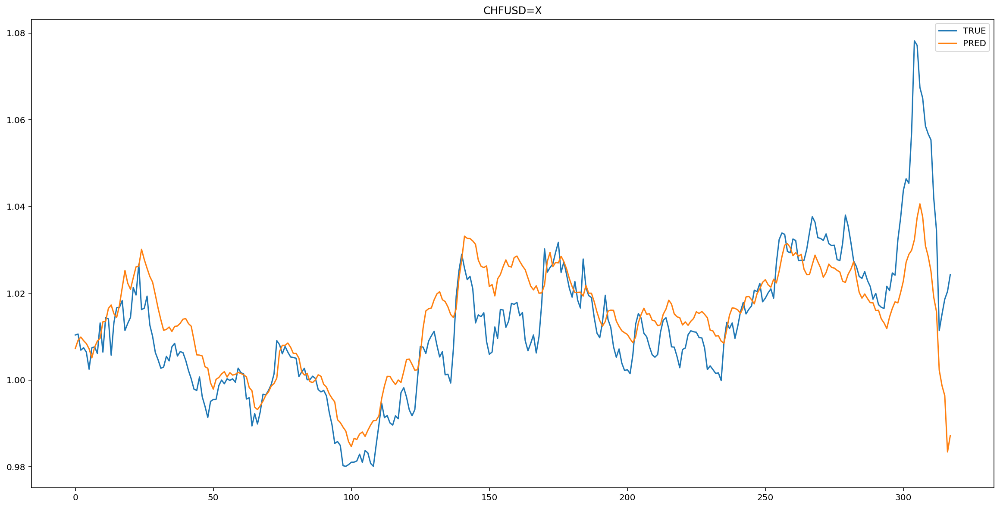

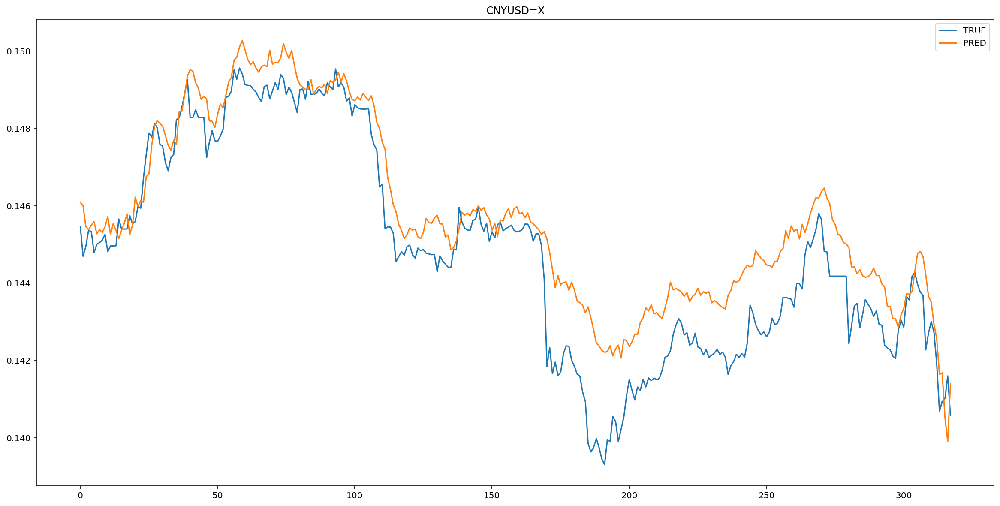

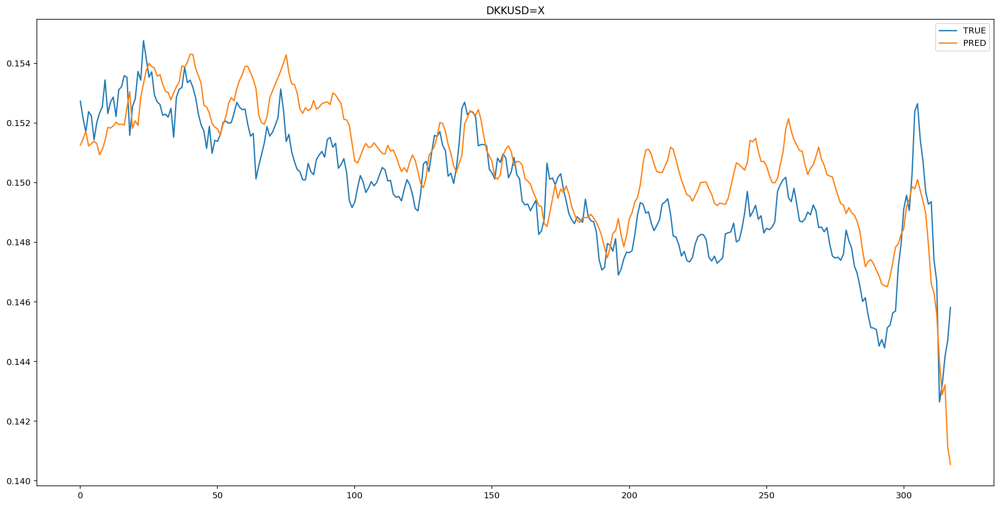

...

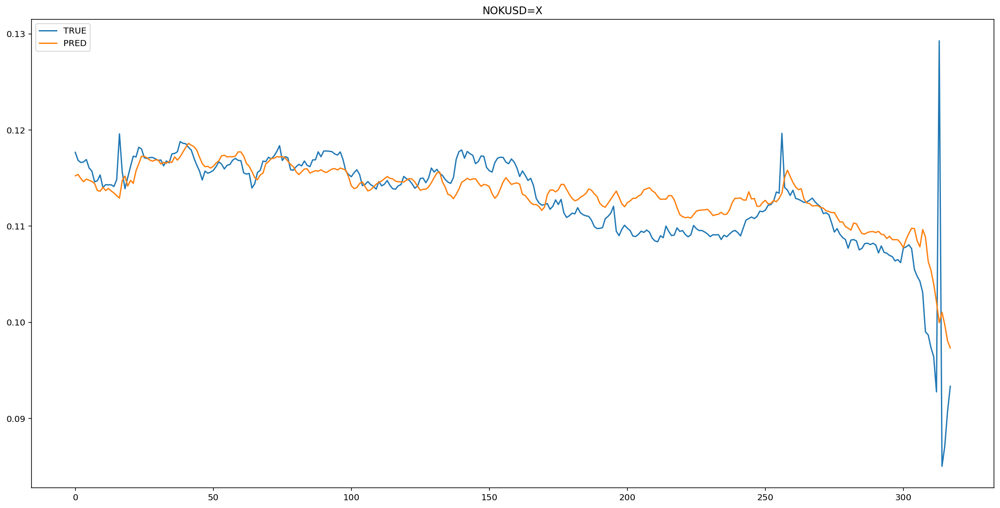

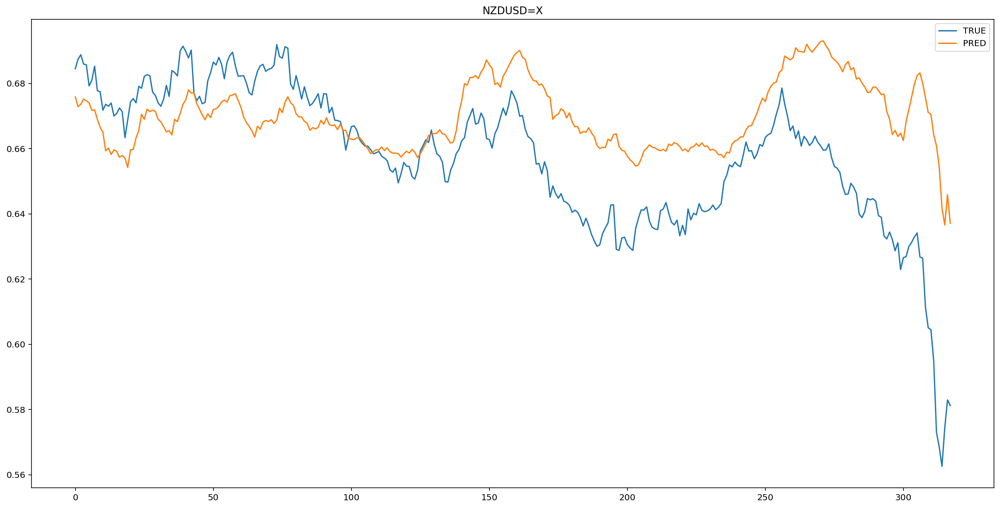

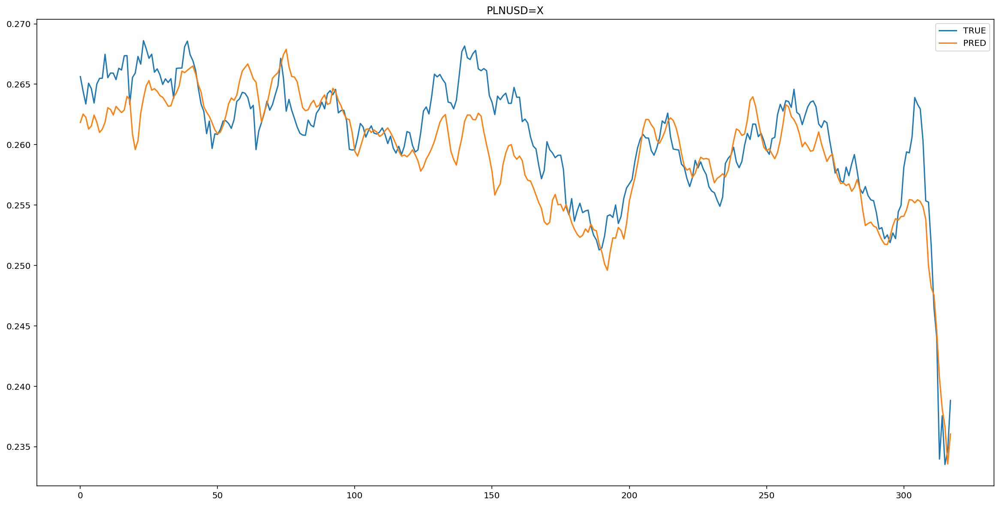

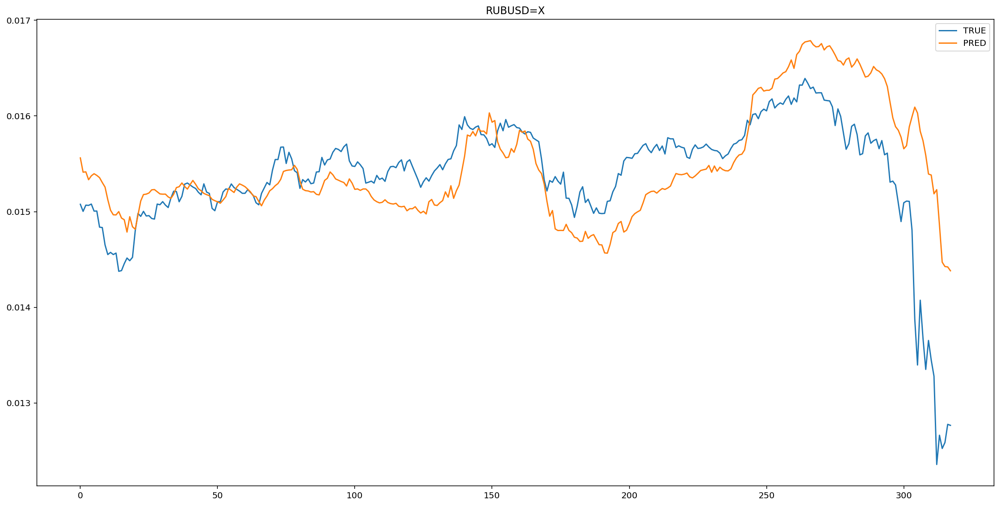

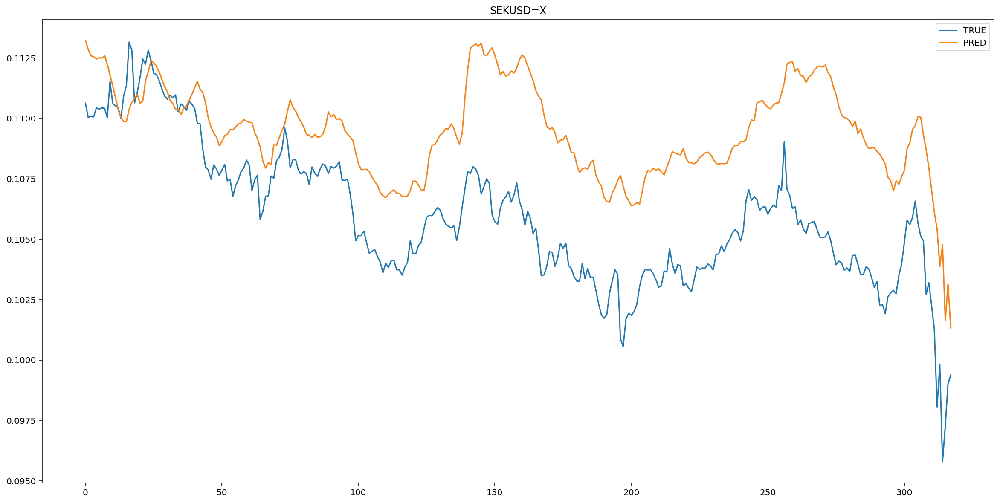

In [71]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [72]:
MSE(y_hat, y_pred)

0.00012908354

In [73]:
RMSE(y_hat, y_pred)

0.011361494

In [74]:
MAE(y_hat, y_pred)

0.0060292934

###Свёрточные

In [ ]:
 # design network

model = Sequential()
model.add(Conv2D(128, (2,2) ,input_shape=(train_X.shape[1], train_X.shape[2], 1), activation='relu'))

model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())
model.add(Dense(64,activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(train_y.shape[1],activation='relu'))

model.compile(loss='mse', optimizer='adam')

In [ ]:
 train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1).shape

(500, 3, 15, 1)

Epoch 1/100
4/4 - 6s - loss: 0.3347 - val_loss: 0.1583
Epoch 2/100
4/4 - 0s - loss: 0.2379 - val_loss: 0.1090
Epoch 3/100
4/4 - 0s - loss: 0.1948 - val_loss: 0.1031
Epoch 4/100
4/4 - 0s - loss: 0.1894 - val_loss: 0.1121
Epoch 5/100
4/4 - 0s - loss: 0.1715 - val_loss: 0.1091
Epoch 6/100
4/4 - 0s - loss: 0.1577 - val_loss: 0.1006
Epoch 7/100
4/4 - 0s - loss: 0.1459 - val_loss: 0.0916
Epoch 8/100
4/4 - 0s - loss: 0.1350 - val_loss: 0.0807
Epoch 9/100
4/4 - 0s - loss: 0.1294 - val_loss: 0.0720
Epoch 10/100
4/4 - 0s - loss: 0.1220 - val_loss: 0.0671
Epoch 11/100
4/4 - 0s - loss: 0.1151 - val_loss: 0.0640
Epoch 12/100
4/4 - 0s - loss: 0.1149 - val_loss: 0.0629
Epoch 13/100
4/4 - 0s - loss: 0.1108 - val_loss: 0.0623
Epoch 14/100
4/4 - 0s - loss: 0.1054 - val_loss: 0.0613
Epoch 15/100
4/4 - 0s - loss: 0.1028 - val_loss: 0.0602
Epoch 16/100
4/4 - 0s - loss: 0.0966 - val_loss: 0.0586
Epoch 17/100
4/4 - 0s - loss: 0.0941 - val_loss: 0.0568
Epoch 18/100
4/4 - 0s - loss: 0.0900 - val_loss: 0.0551
E

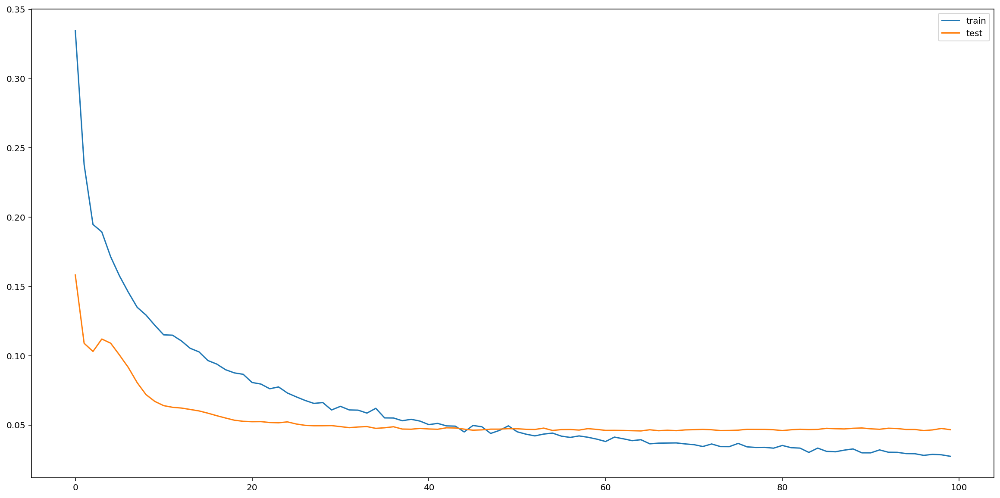

In [ ]:
 # fit network
#history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y, epochs=100, batch_size=128, validation_data=(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1), test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
#y_pred = scaler.inverse_transform(model.predict(test_X))
y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

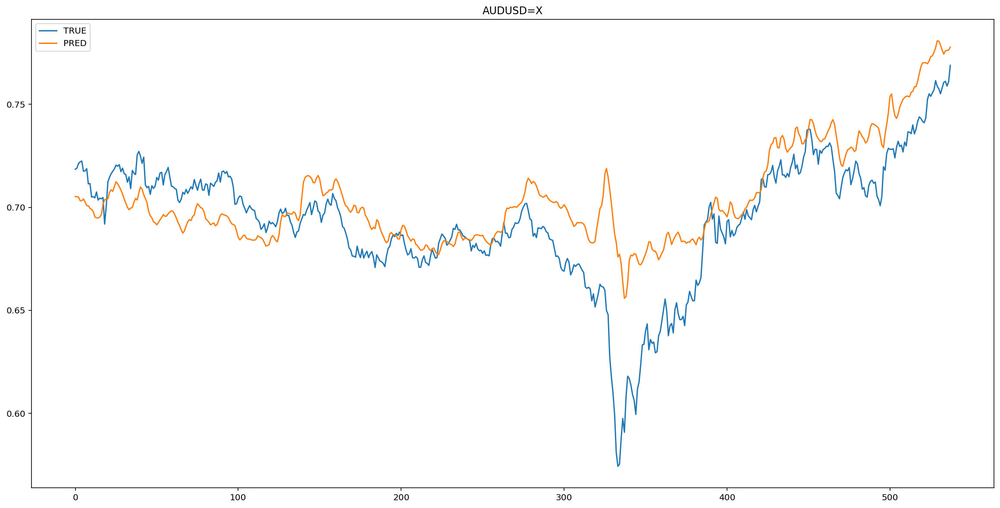

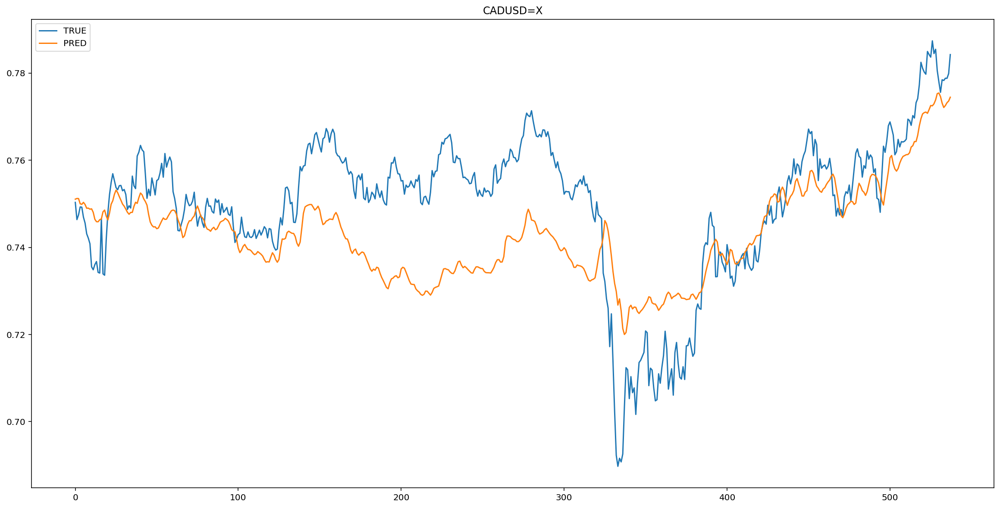

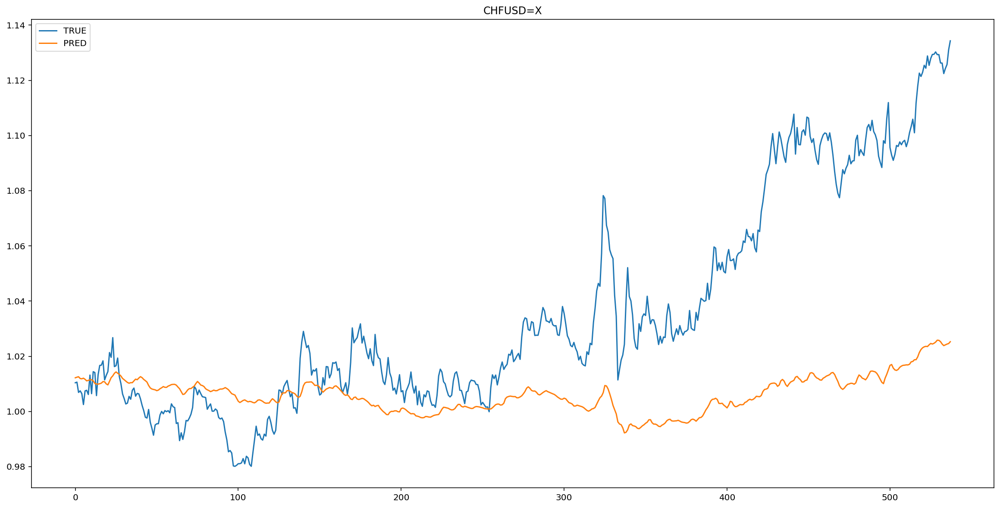

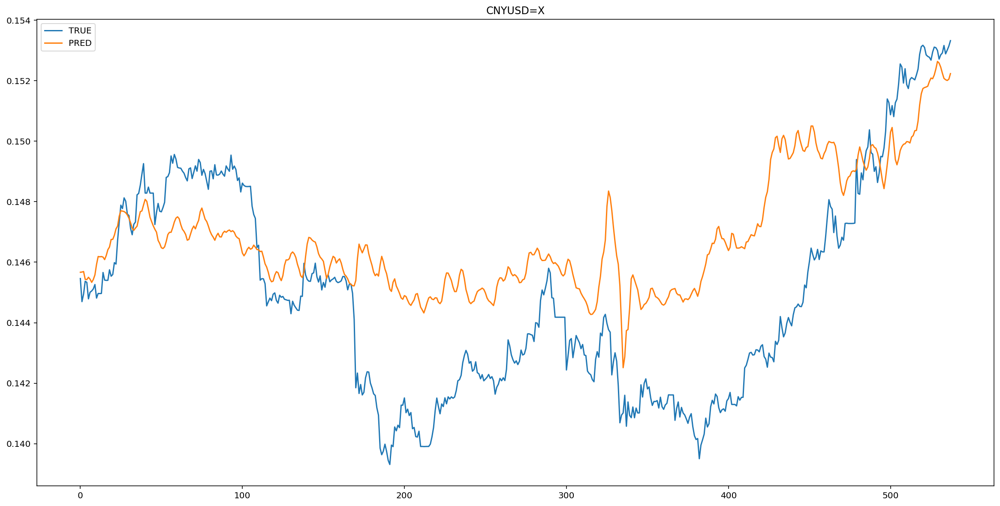

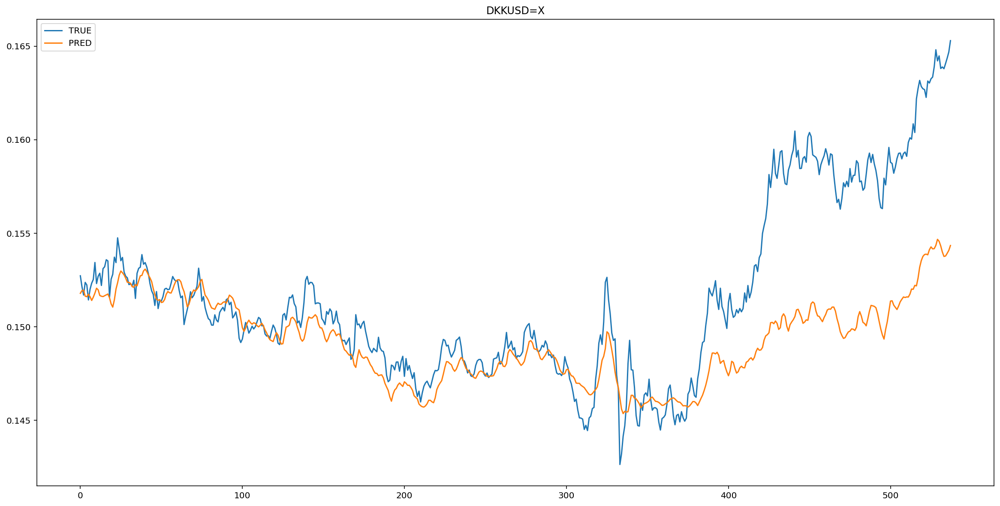

...

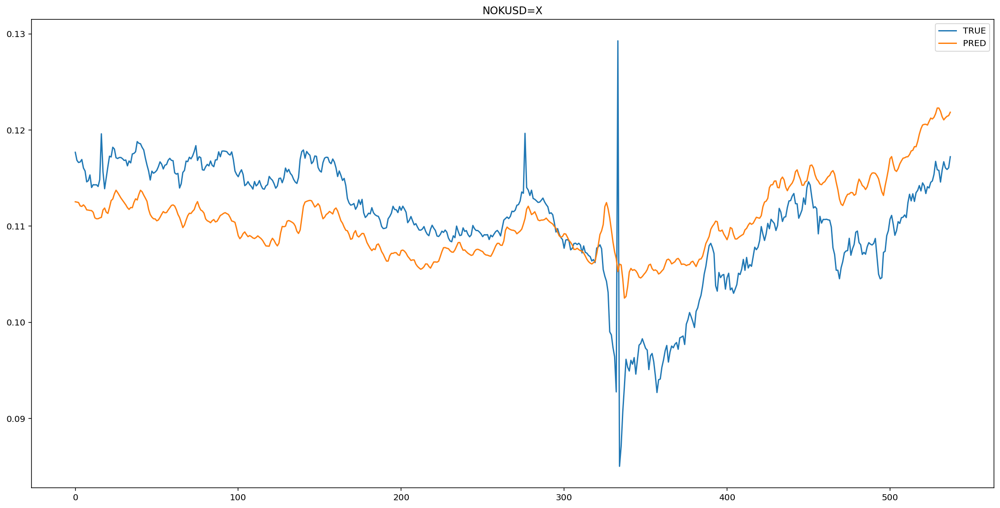

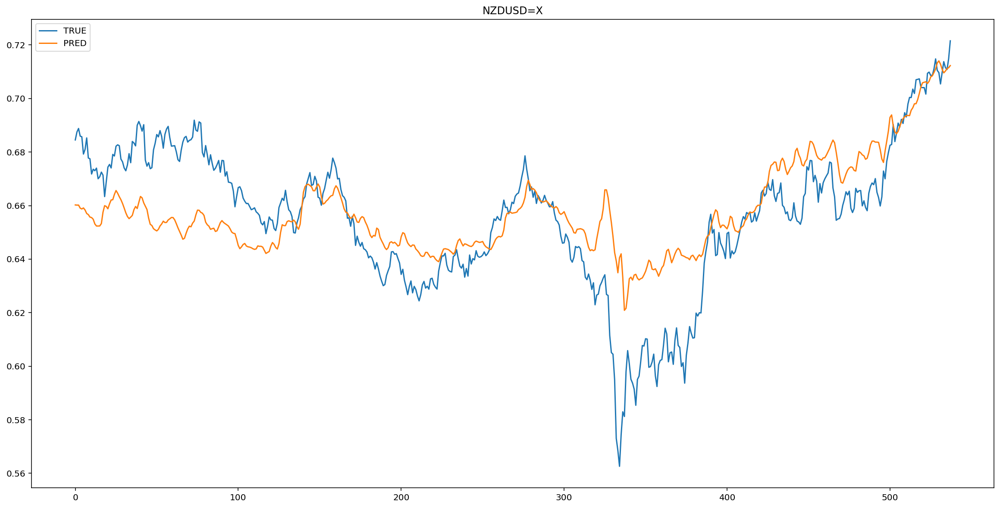

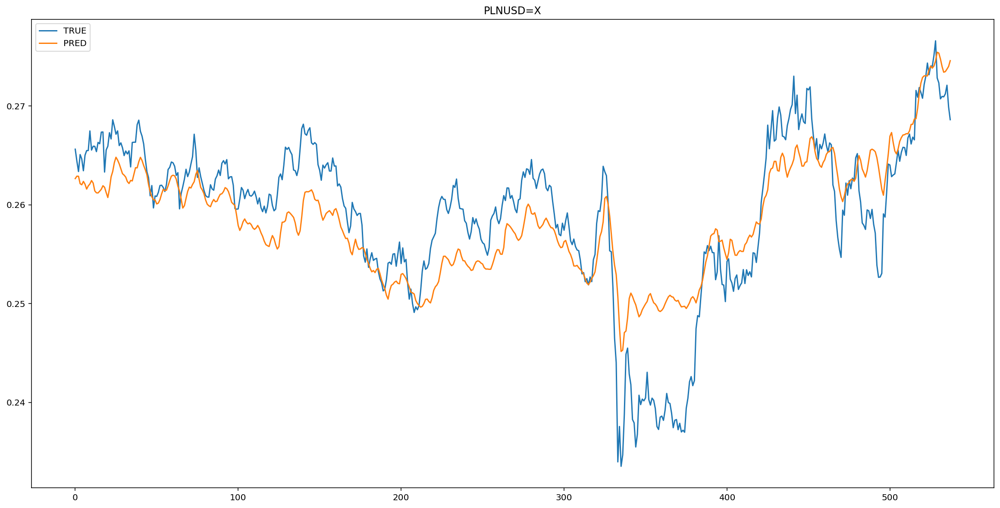

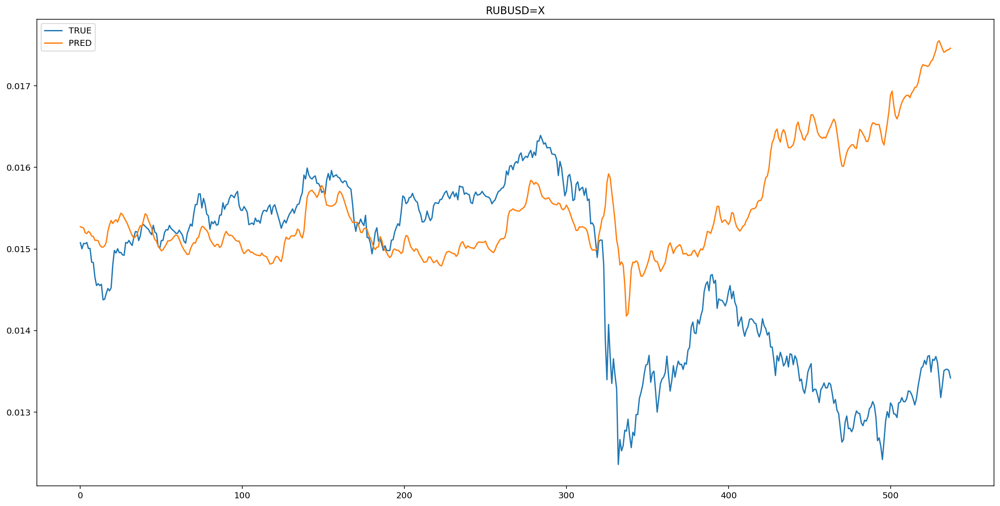

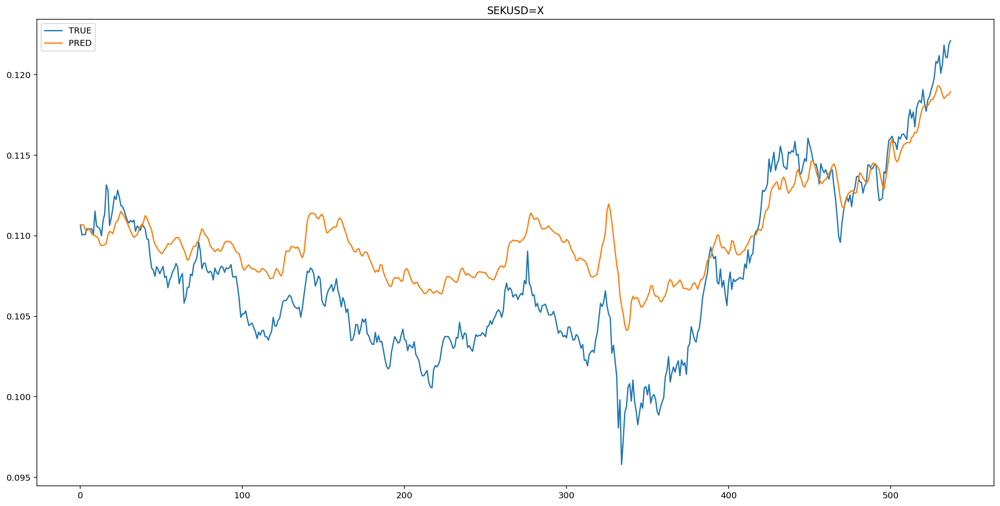

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

5.158564e-05

In [ ]:
RMSE(y_hat, y_pred)

0.0071823145

In [ ]:
MAE(y_hat, y_pred)

0.0033960706

###Рекуррентные

####RNN

In [ ]:
# design network
model = Sequential()
model.add(SimpleRNN(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(SimpleRNN(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
4/4 - 1s - loss: 0.4030 - val_loss: 0.0934
Epoch 2/100
4/4 - 0s - loss: 0.1012 - val_loss: 0.0552
Epoch 3/100
4/4 - 0s - loss: 0.0481 - val_loss: 0.0632
Epoch 4/100
4/4 - 0s - loss: 0.0293 - val_loss: 0.0711
Epoch 5/100
4/4 - 0s - loss: 0.0241 - val_loss: 0.0729
Epoch 6/100
4/4 - 0s - loss: 0.0214 - val_loss: 0.0631
Epoch 7/100
4/4 - 0s - loss: 0.0145 - val_loss: 0.0534
Epoch 8/100
4/4 - 0s - loss: 0.0118 - val_loss: 0.0497
Epoch 9/100
4/4 - 0s - loss: 0.0104 - val_loss: 0.0515
Epoch 10/100
4/4 - 0s - loss: 0.0089 - val_loss: 0.0533
Epoch 11/100
4/4 - 0s - loss: 0.0078 - val_loss: 0.0525
Epoch 12/100
4/4 - 0s - loss: 0.0072 - val_loss: 0.0509
Epoch 13/100
4/4 - 0s - loss: 0.0064 - val_loss: 0.0498
Epoch 14/100
4/4 - 0s - loss: 0.0061 - val_loss: 0.0492
Epoch 15/100
4/4 - 0s - loss: 0.0059 - val_loss: 0.0487
Epoch 16/100
4/4 - 0s - loss: 0.0055 - val_loss: 0.0488
Epoch 17/100
4/4 - 0s - loss: 0.0052 - val_loss: 0.0488
Epoch 18/100
4/4 - 0s - loss: 0.0050 - val_loss: 0.0482
E

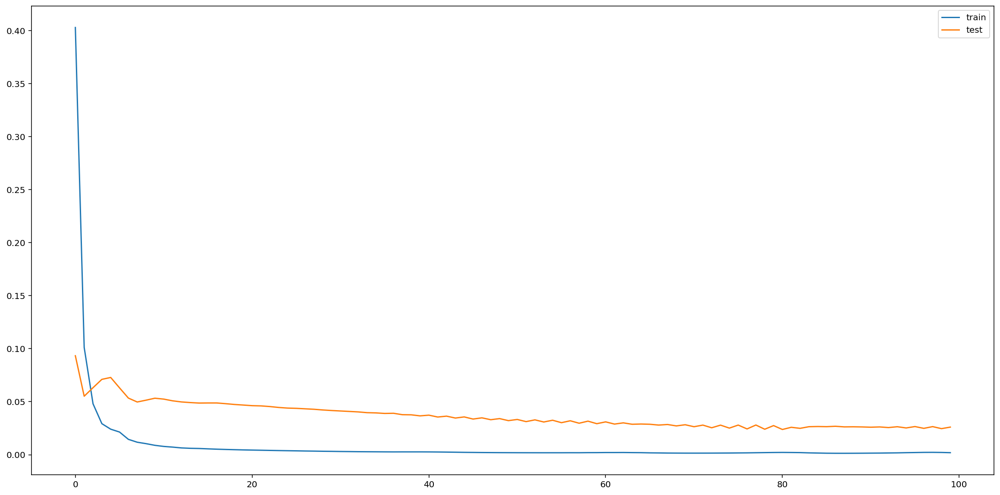

In [ ]:
# fit network
history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

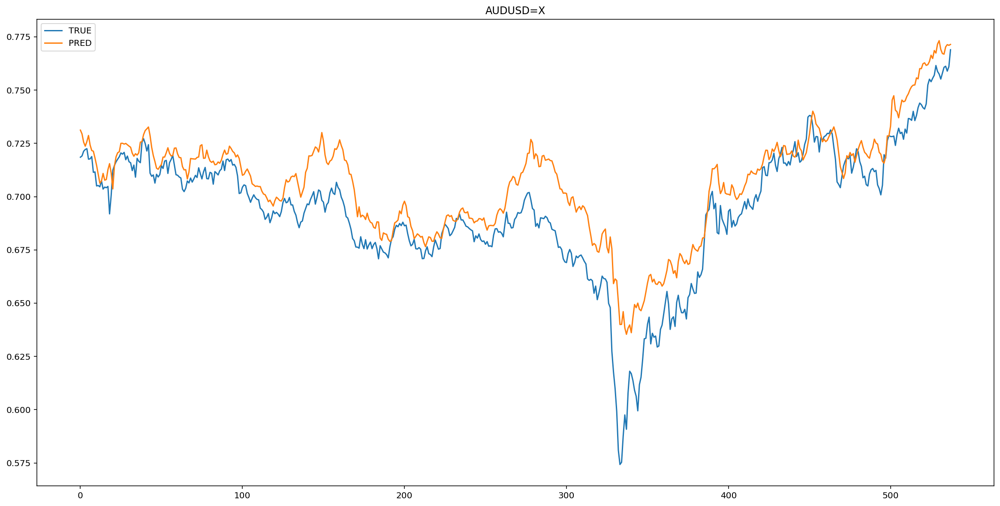

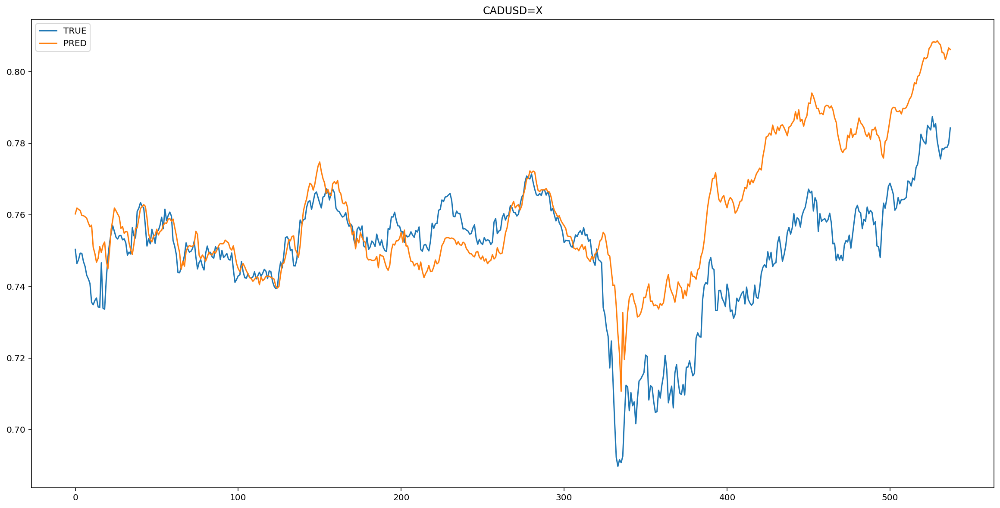

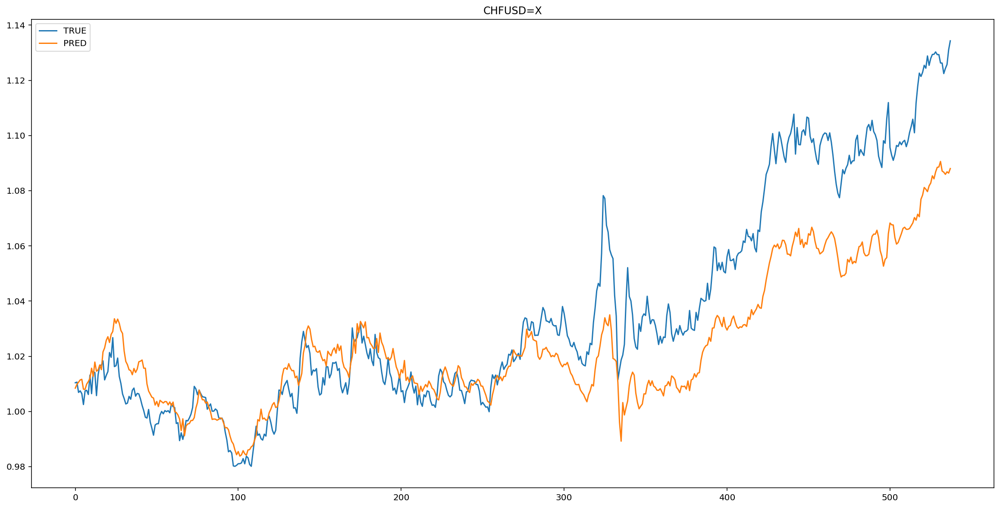

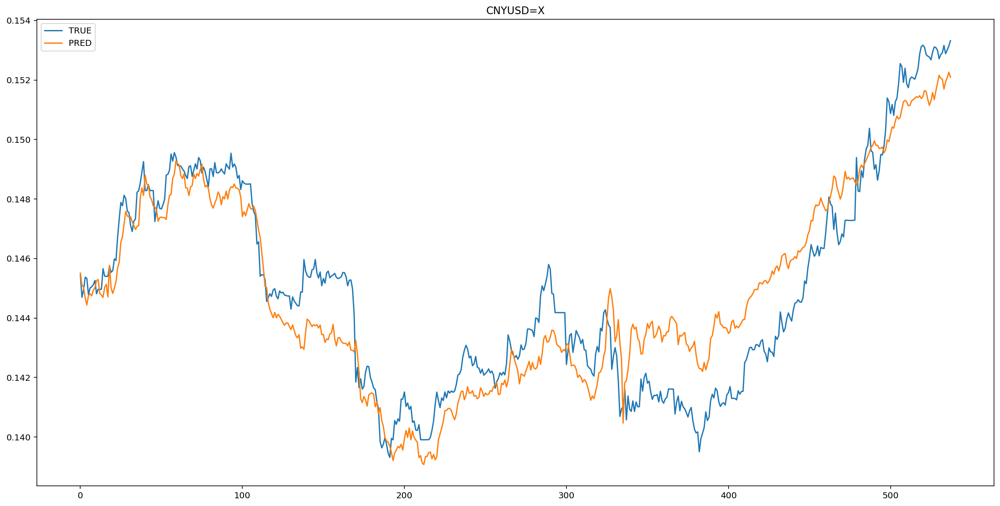

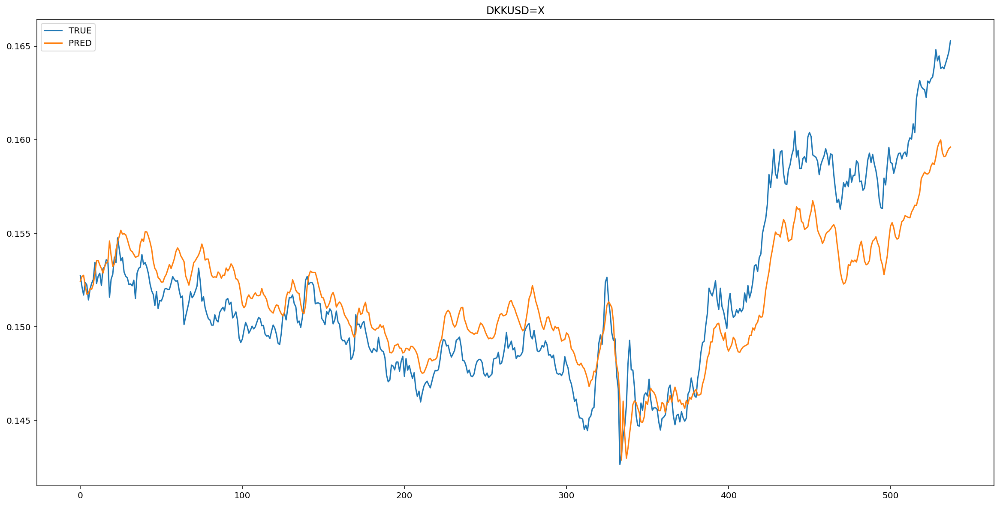

...

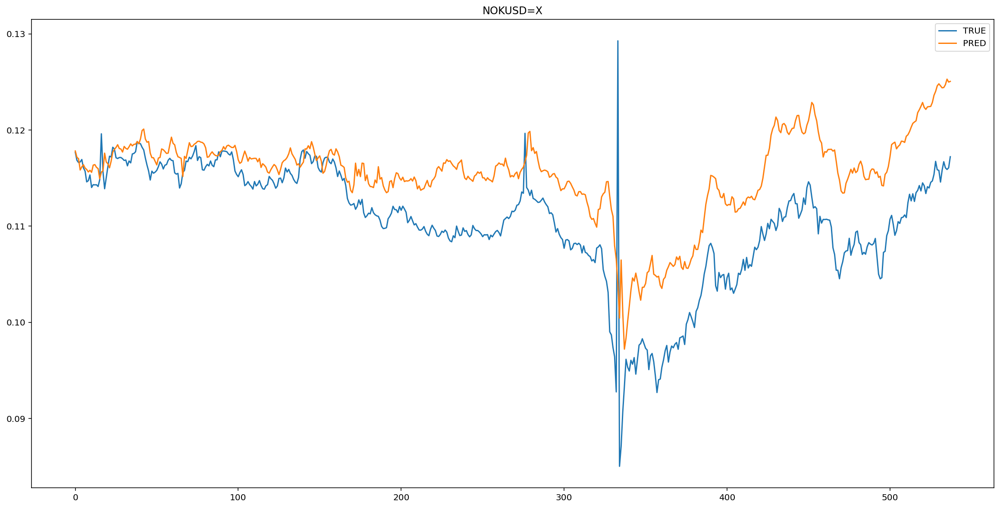

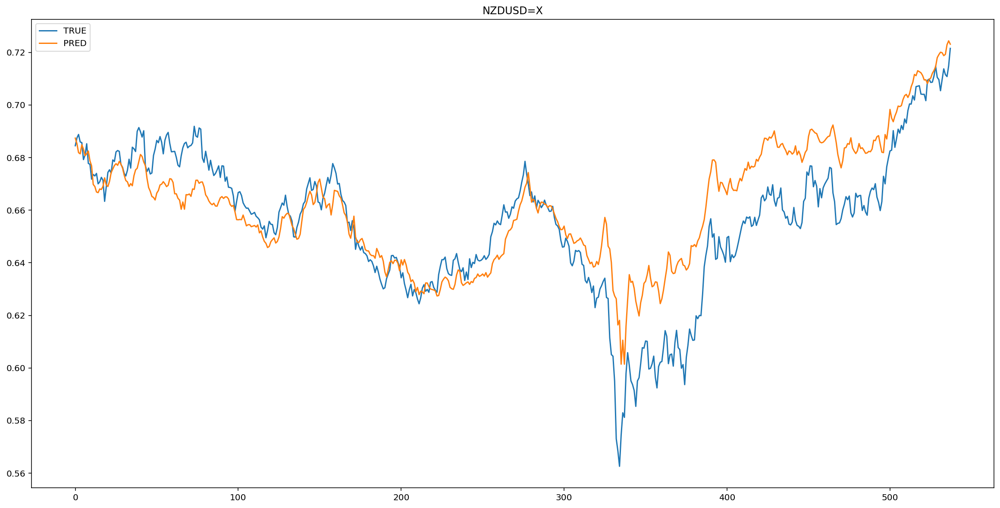

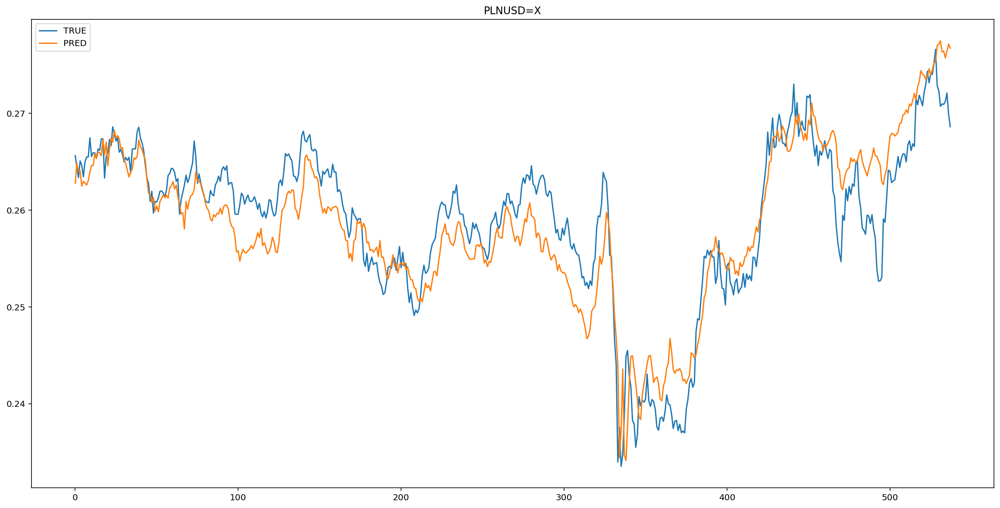

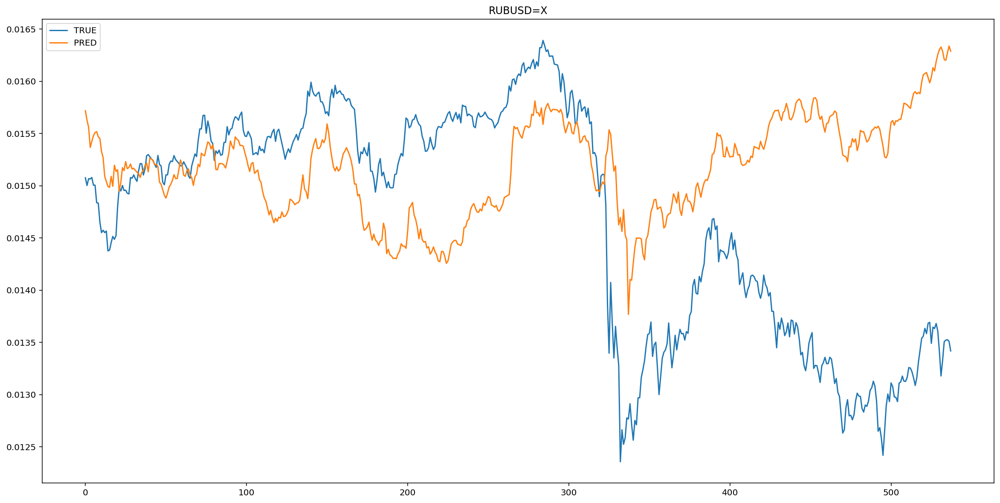

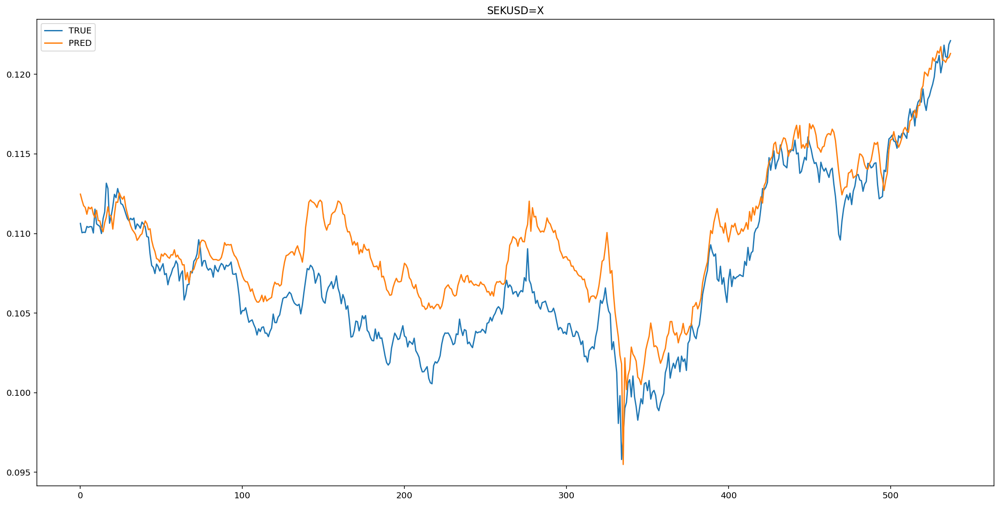

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

####LSTM

In [ ]:
# design network
model = Sequential()
model.add(LSTM(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(LSTM(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
4/4 - 2s - loss: 0.4005 - val_loss: 0.2187
Epoch 2/100
4/4 - 0s - loss: 0.3634 - val_loss: 0.1968
Epoch 3/100
4/4 - 0s - loss: 0.3140 - val_loss: 0.1649
Epoch 4/100
4/4 - 0s - loss: 0.2373 - val_loss: 0.1187
Epoch 5/100
4/4 - 0s - loss: 0.1311 - val_loss: 0.0676
Epoch 6/100
4/4 - 0s - loss: 0.0838 - val_loss: 0.0549
Epoch 7/100
4/4 - 0s - loss: 0.0668 - val_loss: 0.0511
Epoch 8/100
4/4 - 0s - loss: 0.0329 - val_loss: 0.0555
Epoch 9/100
4/4 - 0s - loss: 0.0315 - val_loss: 0.0563
Epoch 10/100
4/4 - 0s - loss: 0.0273 - val_loss: 0.0528
Epoch 11/100
4/4 - 0s - loss: 0.0241 - val_loss: 0.0508
Epoch 12/100
4/4 - 0s - loss: 0.0256 - val_loss: 0.0500
Epoch 13/100
4/4 - 0s - loss: 0.0232 - val_loss: 0.0502
Epoch 14/100
4/4 - 0s - loss: 0.0226 - val_loss: 0.0500
Epoch 15/100
4/4 - 0s - loss: 0.0222 - val_loss: 0.0485
Epoch 16/100
4/4 - 0s - loss: 0.0212 - val_loss: 0.0473
Epoch 17/100
4/4 - 0s - loss: 0.0211 - val_loss: 0.0472
Epoch 18/100
4/4 - 0s - loss: 0.0206 - val_loss: 0.0476
E

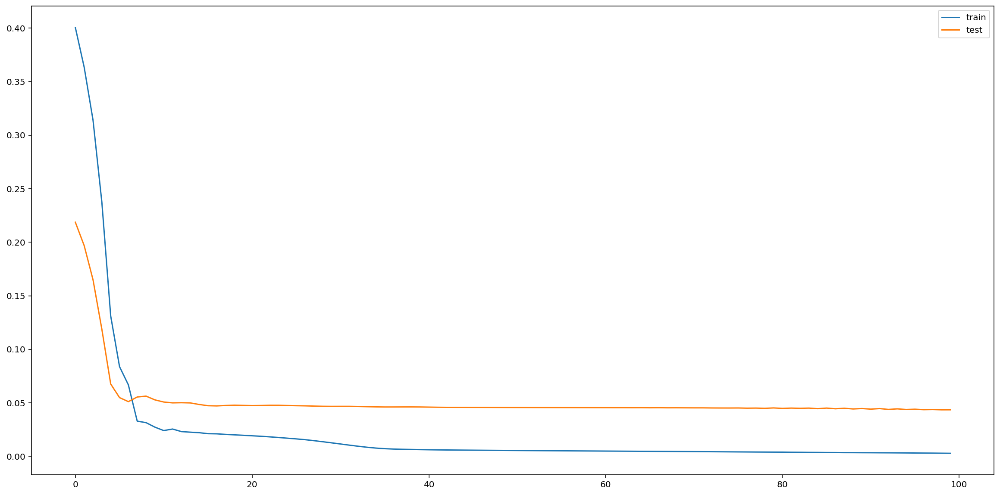

In [ ]:
# fit network
history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

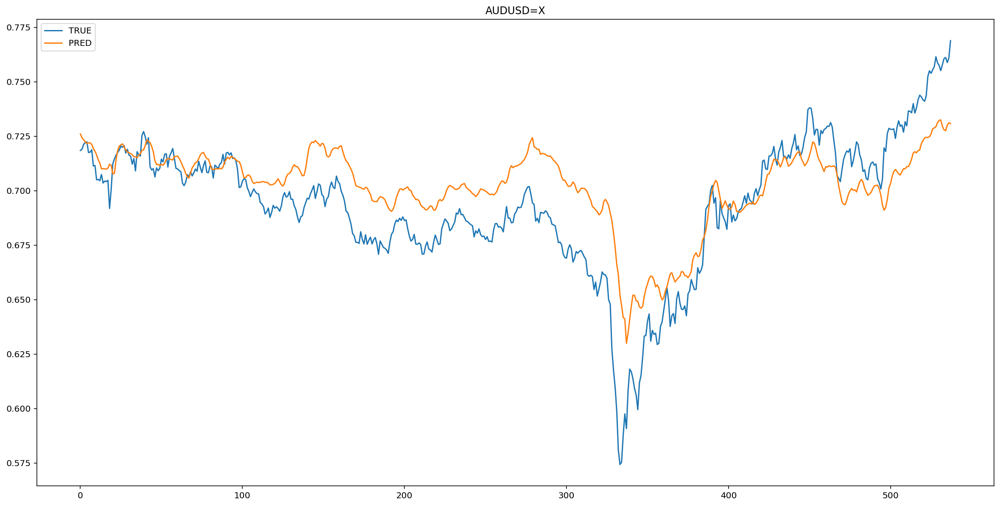

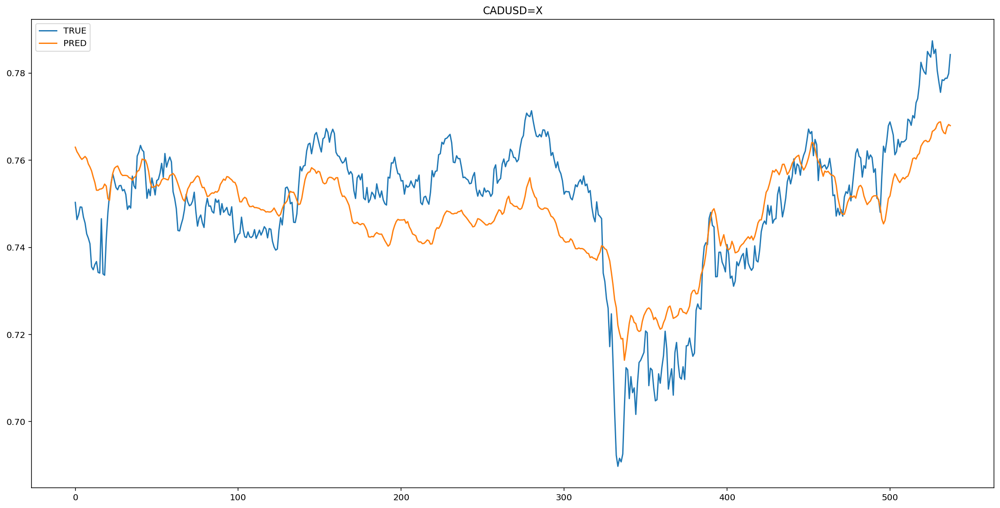

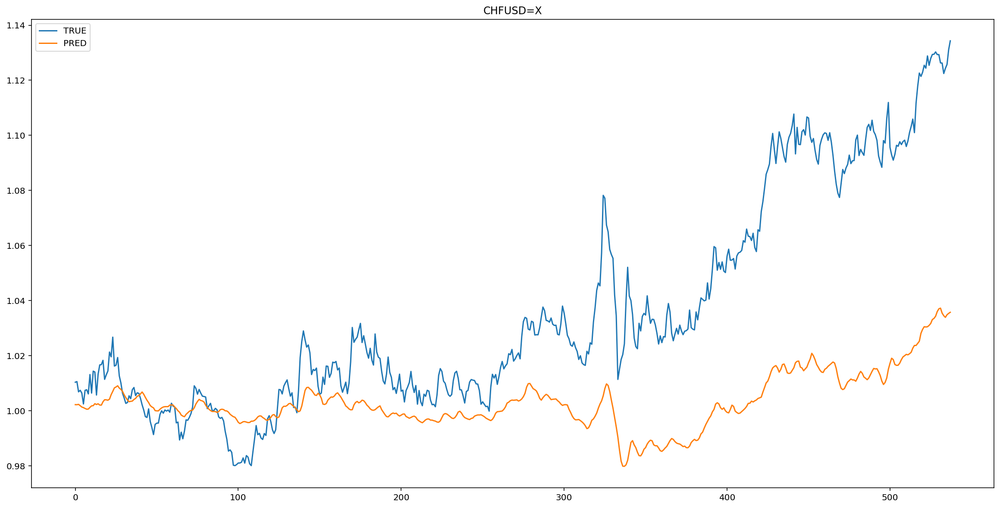

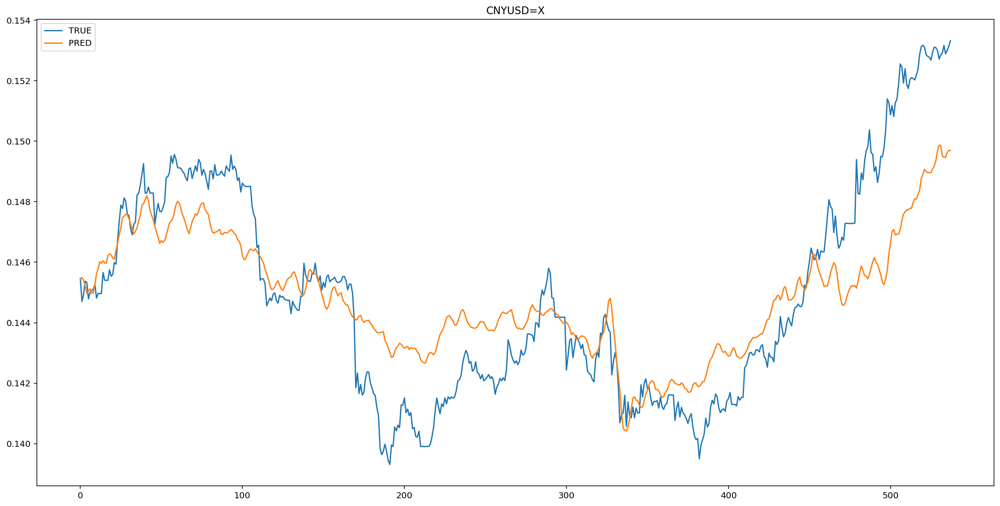

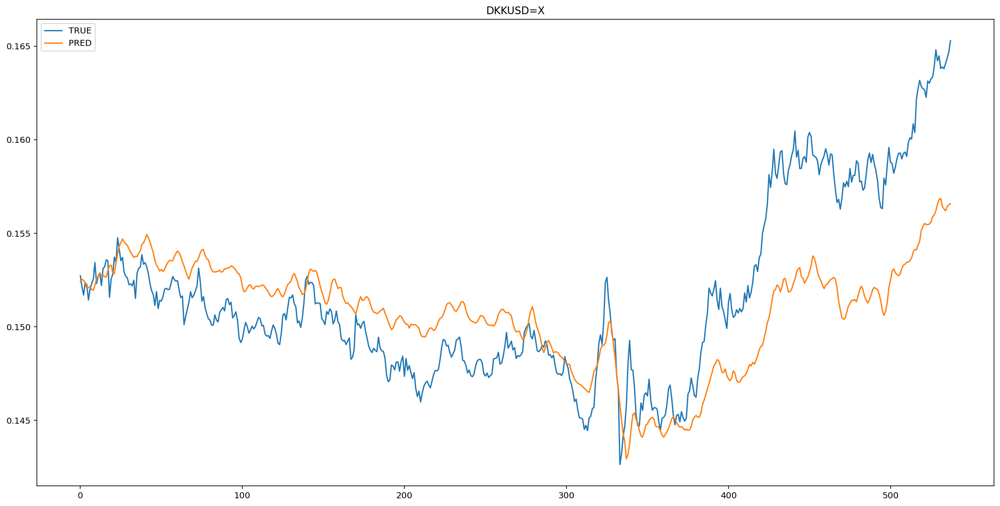

...

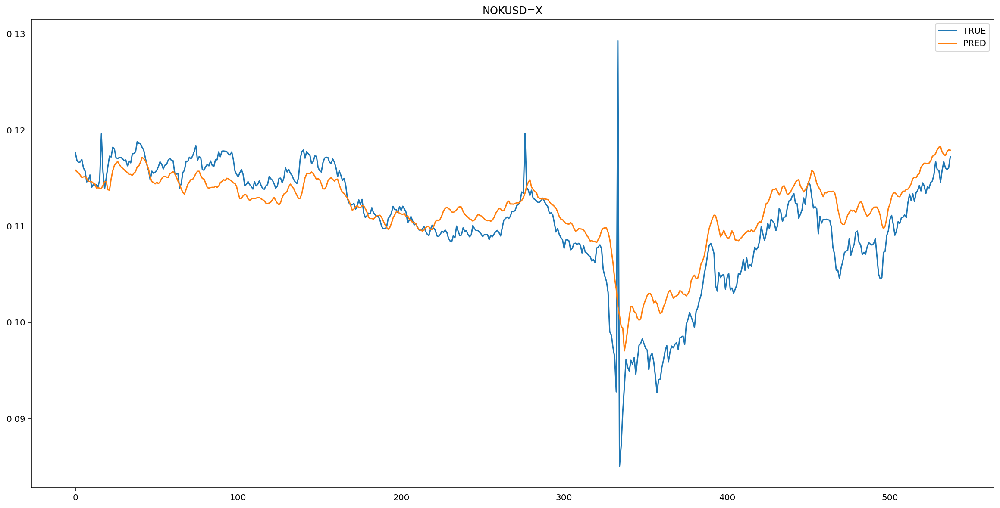

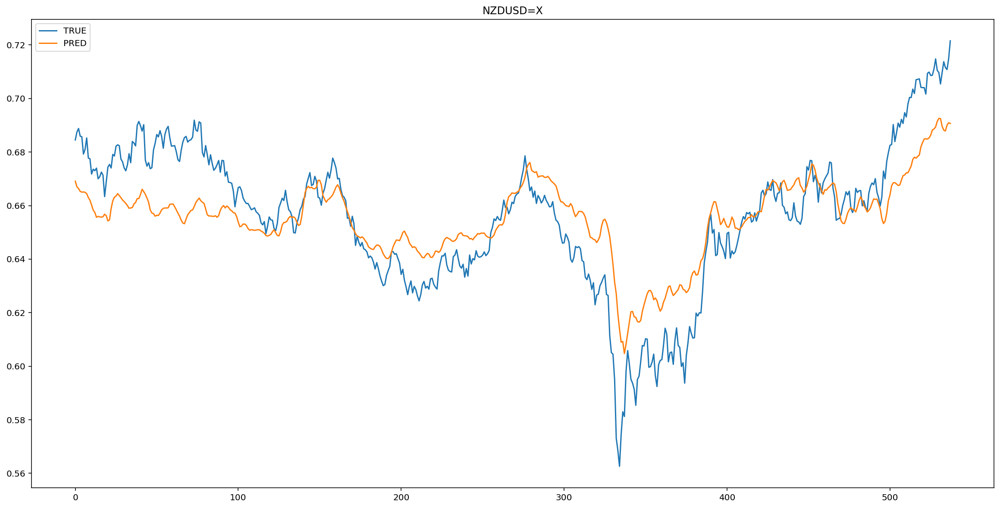

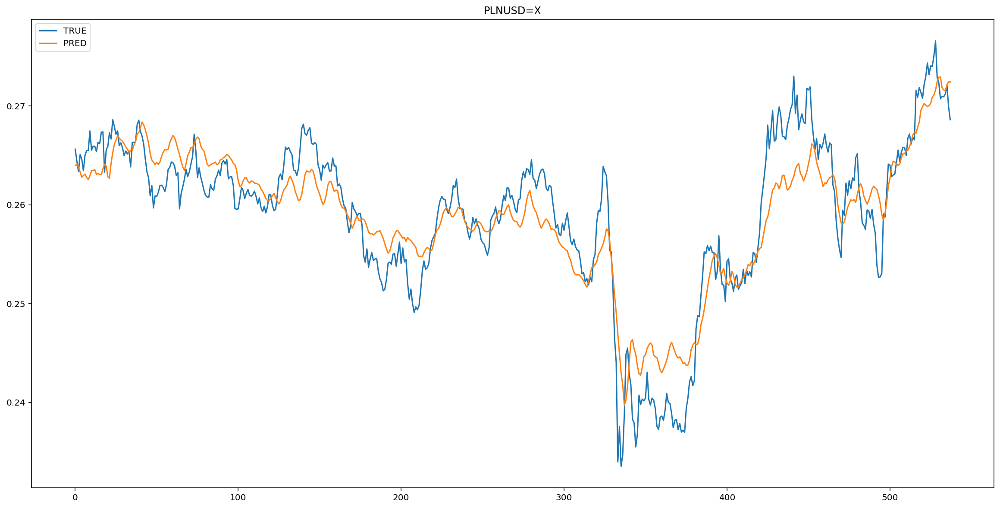

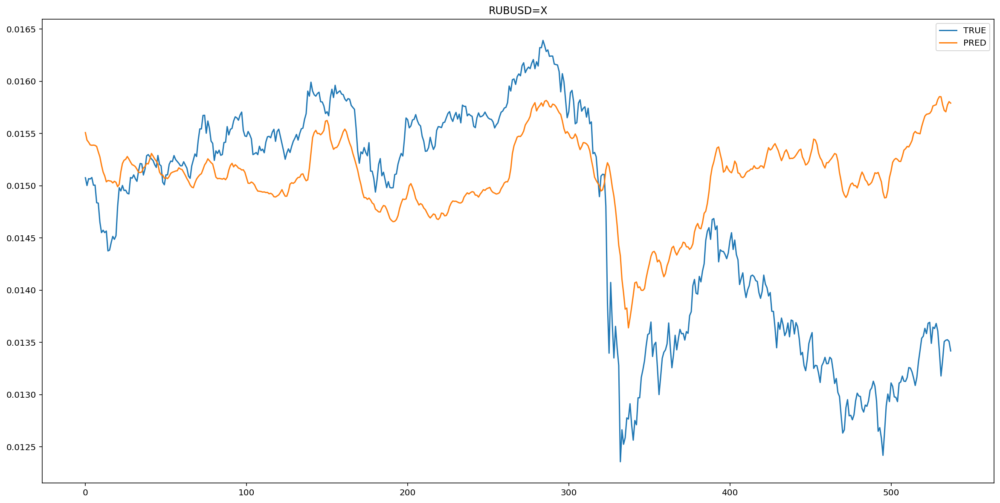

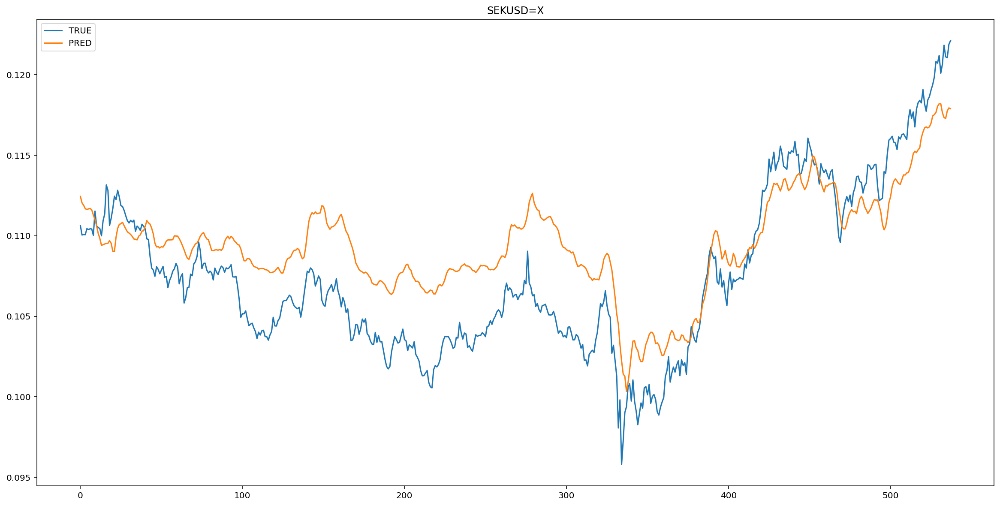

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

####GRU

In [ ]:
# design network
model = Sequential()
model.add(GRU(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(GRU(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
4/4 - 2s - loss: 0.3629 - val_loss: 0.1802
Epoch 2/100
4/4 - 0s - loss: 0.2556 - val_loss: 0.1265
Epoch 3/100
4/4 - 0s - loss: 0.1420 - val_loss: 0.0797
Epoch 4/100
4/4 - 0s - loss: 0.0574 - val_loss: 0.0775
Epoch 5/100
4/4 - 0s - loss: 0.0583 - val_loss: 0.0725
Epoch 6/100
4/4 - 0s - loss: 0.0346 - val_loss: 0.0522
Epoch 7/100
4/4 - 0s - loss: 0.0224 - val_loss: 0.0477
Epoch 8/100
4/4 - 0s - loss: 0.0261 - val_loss: 0.0458
Epoch 9/100
4/4 - 0s - loss: 0.0238 - val_loss: 0.0445
Epoch 10/100
4/4 - 0s - loss: 0.0199 - val_loss: 0.0462
Epoch 11/100
4/4 - 0s - loss: 0.0189 - val_loss: 0.0480
Epoch 12/100
4/4 - 0s - loss: 0.0168 - val_loss: 0.0481
Epoch 13/100
4/4 - 0s - loss: 0.0148 - val_loss: 0.0483
Epoch 14/100
4/4 - 0s - loss: 0.0141 - val_loss: 0.0483
Epoch 15/100
4/4 - 0s - loss: 0.0129 - val_loss: 0.0479
Epoch 16/100
4/4 - 0s - loss: 0.0117 - val_loss: 0.0474
Epoch 17/100
4/4 - 0s - loss: 0.0107 - val_loss: 0.0466
Epoch 18/100
4/4 - 0s - loss: 0.0096 - val_loss: 0.0458
E

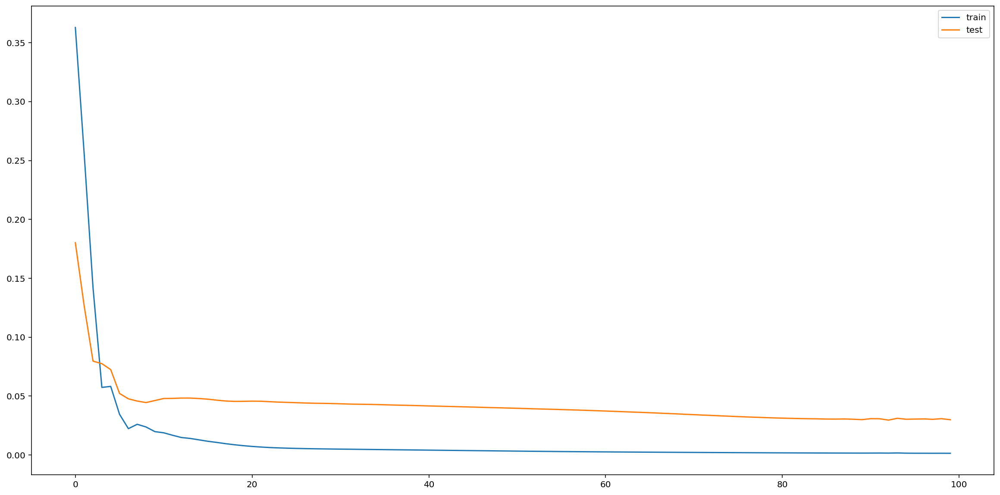

In [ ]:
# fit network
history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [ ]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

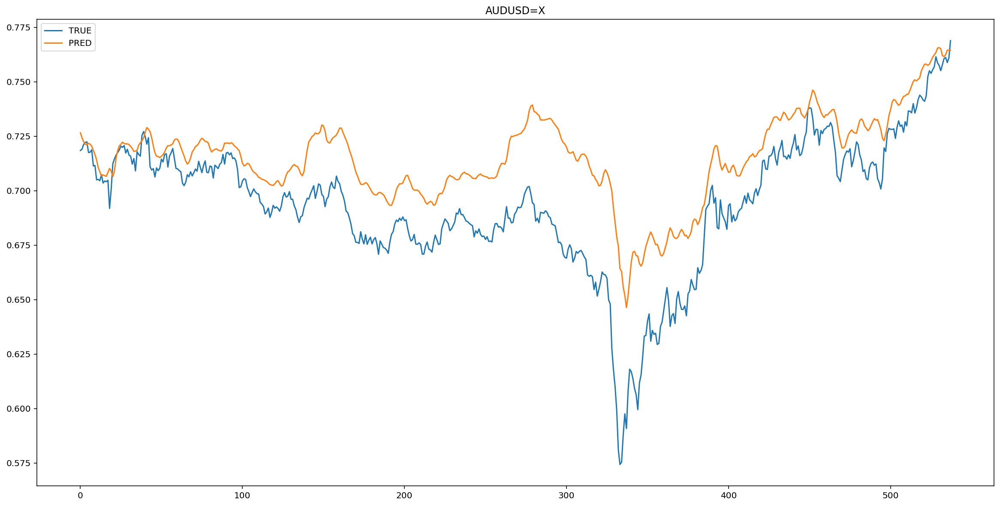

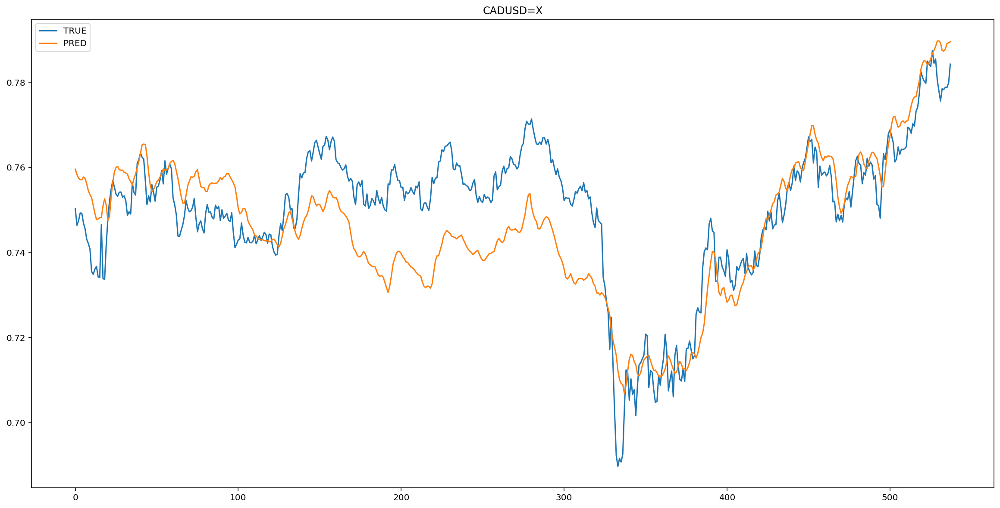

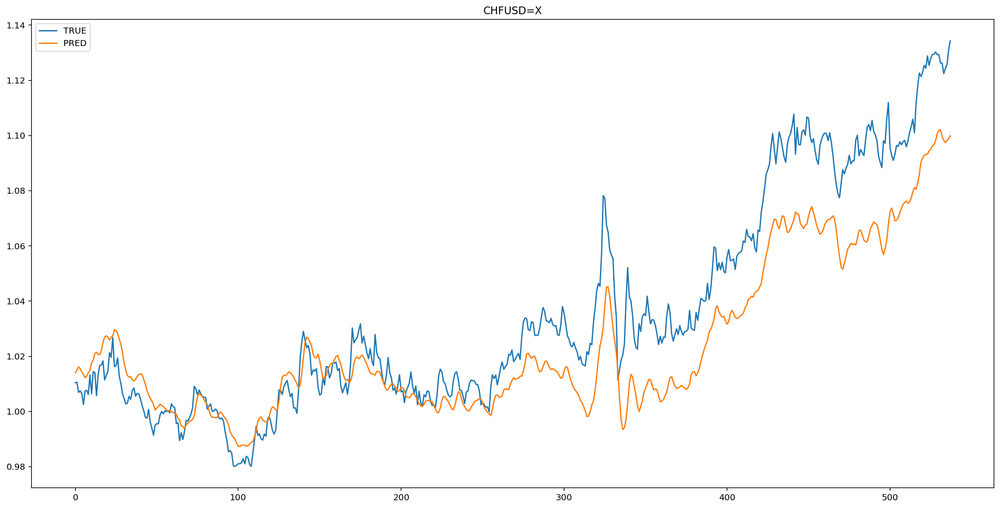

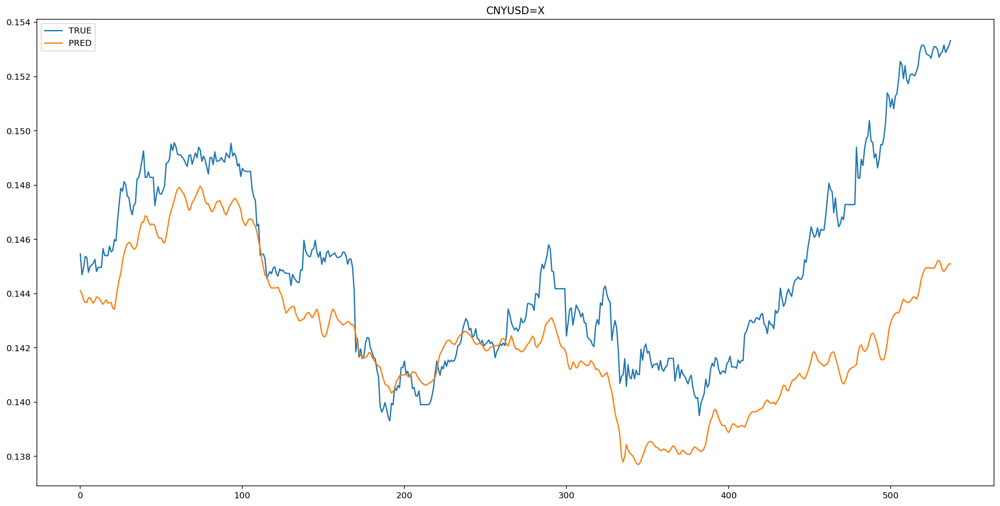

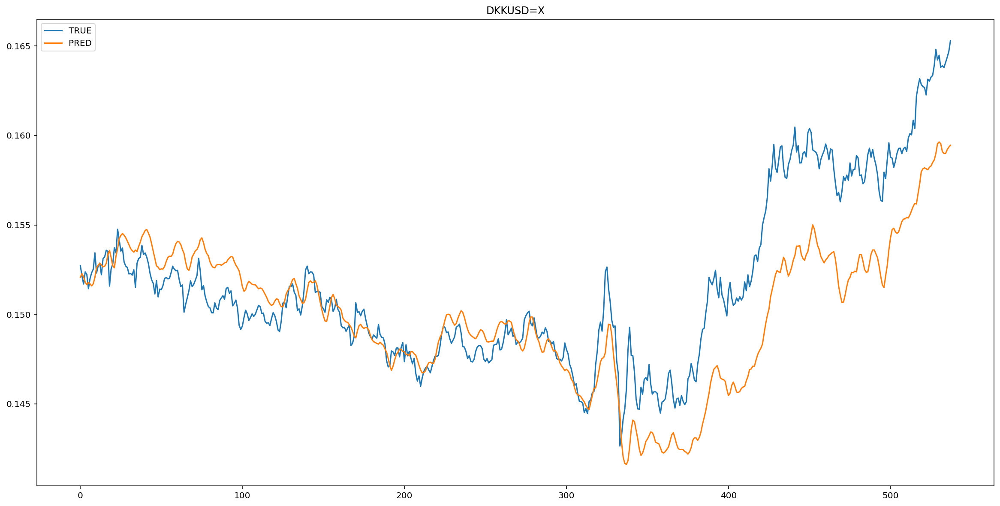

...

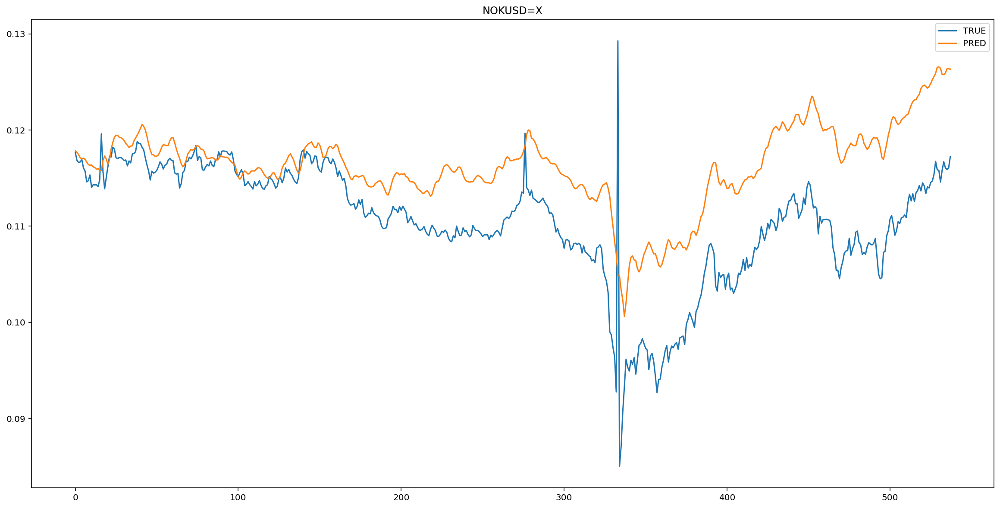

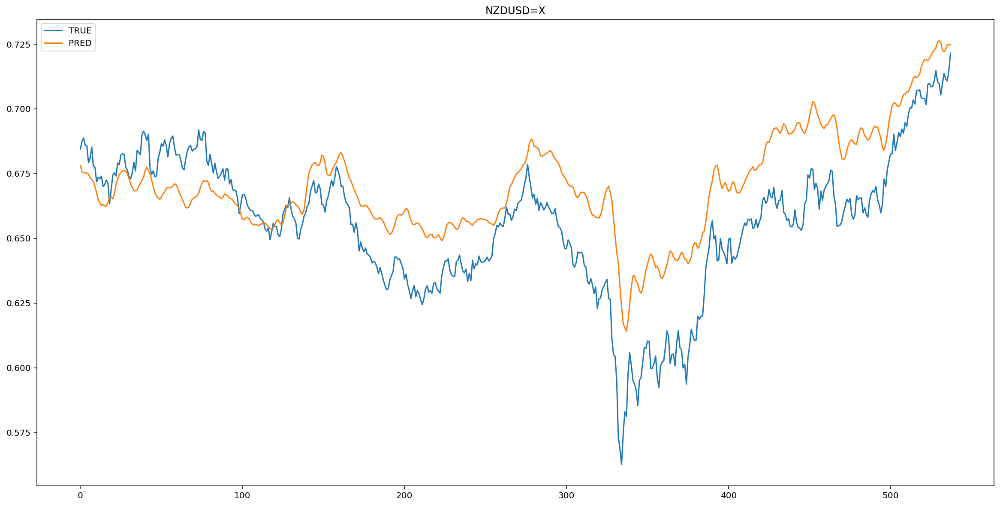

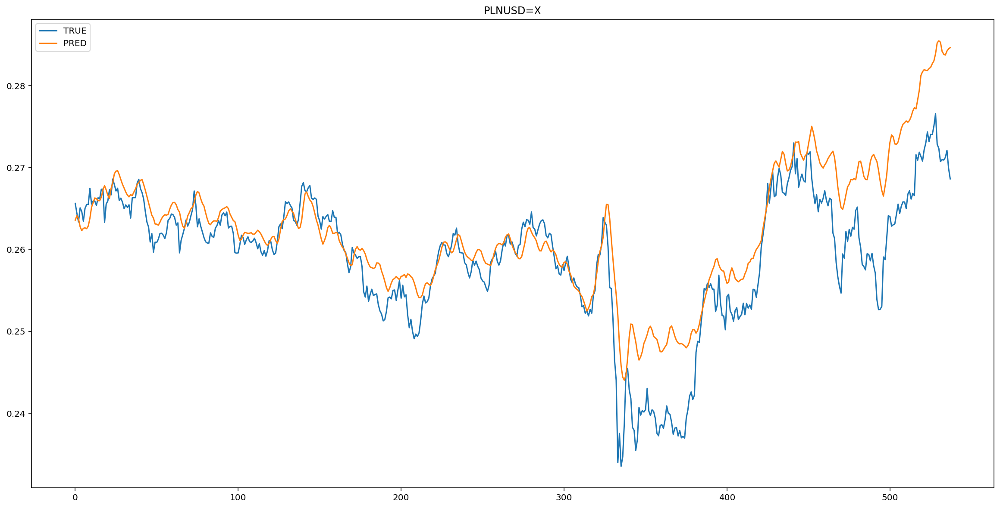

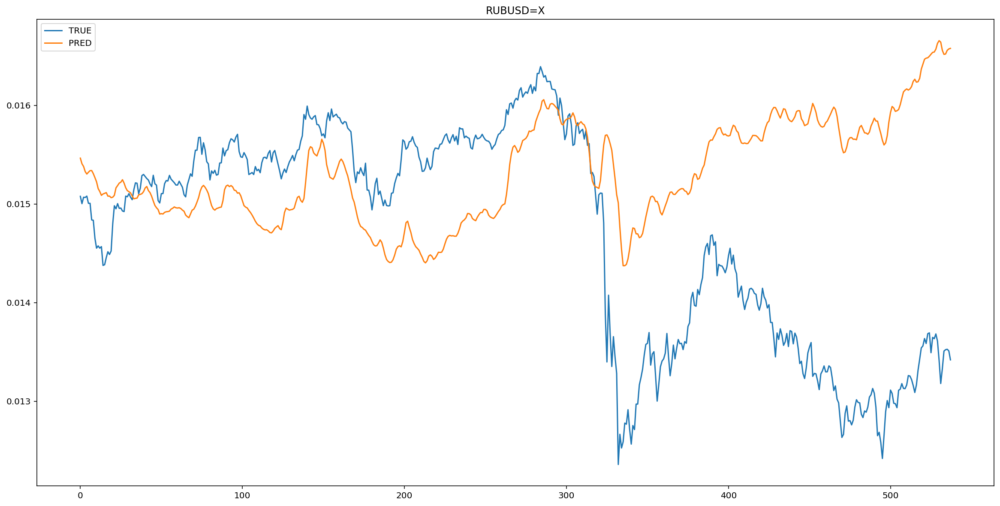

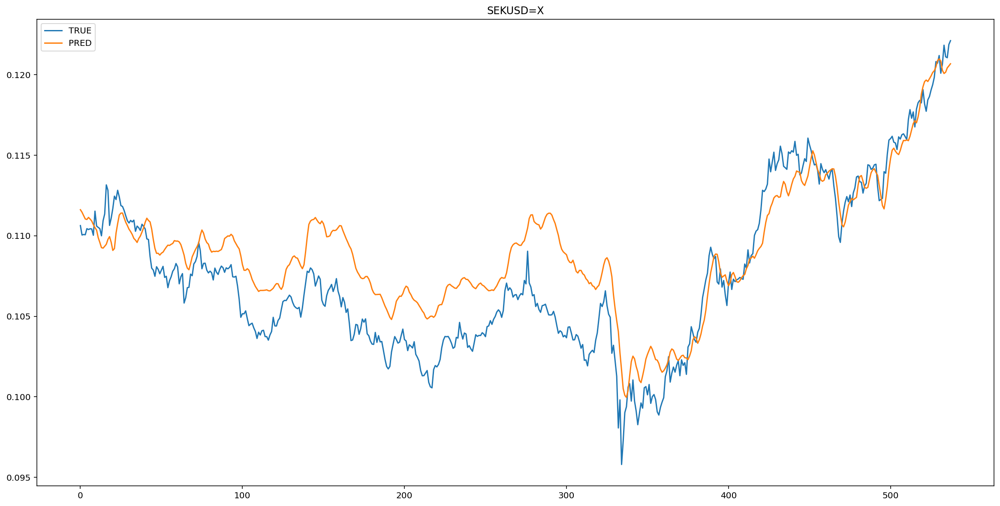

In [ ]:
 for i in range(n_features):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

Оцениваем точность

####Комбинированные

Оцениваем точность

###Комбинации

####Оцениваем точность

In [ ]:
MSE(y_hat, y_pred)

5.158564e-05

In [ ]:
RMSE(y_hat, y_pred)

0.0071823145

In [ ]:
MAE(y_hat, y_pred)

0.0033960706

#Сравнение

Таблица: